In [2]:
import os
import numpy as np
import glob
import re
import matplotlib.pyplot as plt
import scipy
import matplotlib.colors as mcolors
from scipy.signal import spectrogram
from matplotlib import gridspec
import pandas as pd


%cd /media/Projects/Adrian/seizureProcessing/
#%cd /Users/adriangutierrezgomez/Documents/seizureProcessing/

from seizureProcessing.utils.loadNCS import *
from seizureProcessing.utils.get_chnames import *
from seizureProcessing.utils.readMatfile import *
from seizureProcessing.lfp.butter_lowpass_filter import *
from seizureProcessing.utils.from_macro_to_micro_names import *
from seizureProcessing.utils.from_micro_to_macro_names import *
from seizureProcessing.utils.get_patinfo_from_path import *
from seizureProcessing.utils.from_micro_to_macro_names import *

%cd /media/Projects/Adrian/SD_analysis/

from filesystem_handlers import *
from make_basic_dataframe import *
from plotter import *
from spectral_analysis import *

/media/Projects/Adrian/seizureProcessing
/media/Projects/Adrian/SD_analysis


# 0) Set all paths for data

In [3]:
path = '/media/Seizures/60min_cut/081/2019-12-11_17-55-33/'
macropath = os.path.join(path, 'macro')
outpath_base = '/media/Seizures/Wenzel/sd_determination_plots/'
dframe_outpath = '/media/Seizures/Wenzel/dataframes_patpool'
pnr, sznr = get_patinfo_from_path(path)
fname = f'patdata_{pnr}_{sznr}.pkl'
outpath =  os.path.join(outpath_base, pnr+'_'+sznr)

plt_spath = os.path.join(outpath, 'seizure_onset_plots')
plt_spath_macro= os.path.join(os.path.join(plt_spath,'macro'))

# 1) Load dataframe if existing, otherwise generate dataframe

In [6]:
if os.path.isfile(os.path.join(dframe_outpath, fname)):
    print('loaded dataframe:')
    load_df = pd.read_pickle(os.path.join(dframe_outpath, fname))
else:
    print(f'created dataframe and saved in {dframe_outpath}:')
    dataDf = make_basic_dataframe(path)
    modifyValueToDataframe(dataDf, val=1, col='seizureinvaded')
    dataDf.to_pickle(os.path.join(dframe_outpath, fname)) 
    load_df = pd.read_pickle(os.path.join(dframe_outpath, fname))
    
load_df

loaded dataframe:


,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_sec,fname,seizureinvaded,SO_index,sdinvaded_ch,sdonset_sec,sdend_sec,sdinvaded_region,seizuretermination_sec
0,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RAH1,RAH,R,1000,1800,CSC1.ncs,1.0,1800000.0,1,1874,1882,1,
1,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RAH2,RAH,R,1000,1800,CSC2.ncs,1.0,1800000.0,,,1882,1,
2,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RAH3,RAH,R,1000,1800,CSC3.ncs,1.0,1800000.0,1,1874,1882,1,
3,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RAH4,RAH,R,1000,1800,CSC4.ncs,1.0,1800000.0,,,1882,1,
4,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RAH5,RAH,R,1000,1800,CSC5.ncs,1.0,1800000.0,,,1882,1,
5,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RAH6,RAH,R,1000,1800,CSC6.ncs,1.0,1800000.0,,,1882,1,
6,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RAH7,RAH,R,1000,1800,CSC7.ncs,1.0,1800000.0,1,1874,1882,1,
7,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RAH8,RAH,R,1000,1800,CSC8.ncs,1.0,1800000.0,,,1882,1,
8,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RTa1,RTa,R,1000,1800,CSC9.ncs,1.0,1800000.0,,,,,1833
9,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RTa2,RTa,R,1000,1800,CSC10.ncs,1.0,1800000.0,,,,,1833


In [111]:
np.unique(load_df['SO_sec']).tolist()

[1800, 1810]

# 2) Generate first plots

creating path for saving: /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/plots_so_determination
saving plot LA_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/plots_so_determination


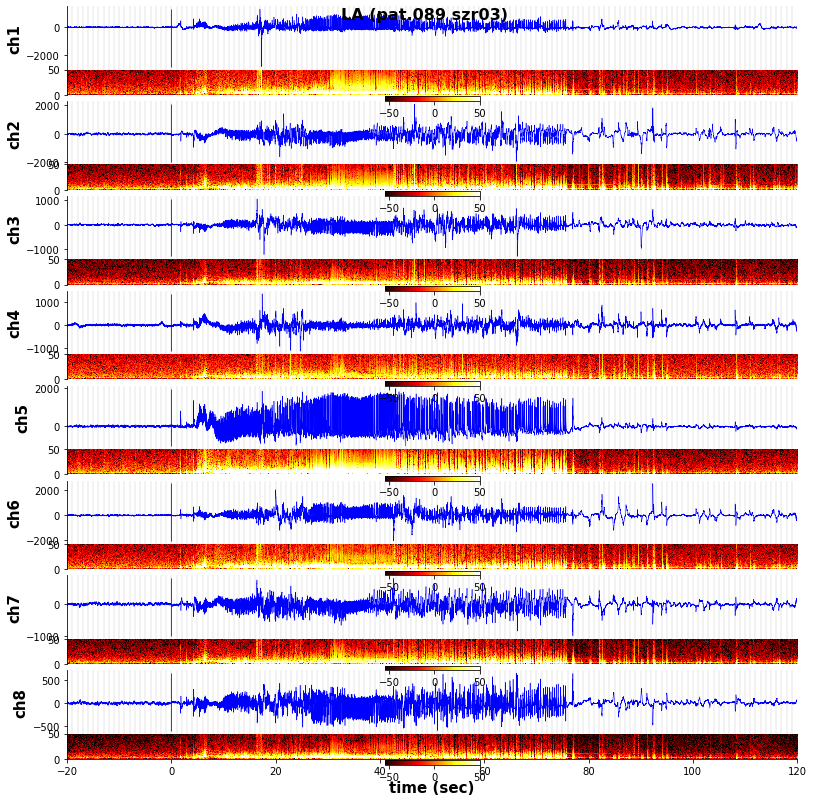

saving plot LAH_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/plots_so_determination


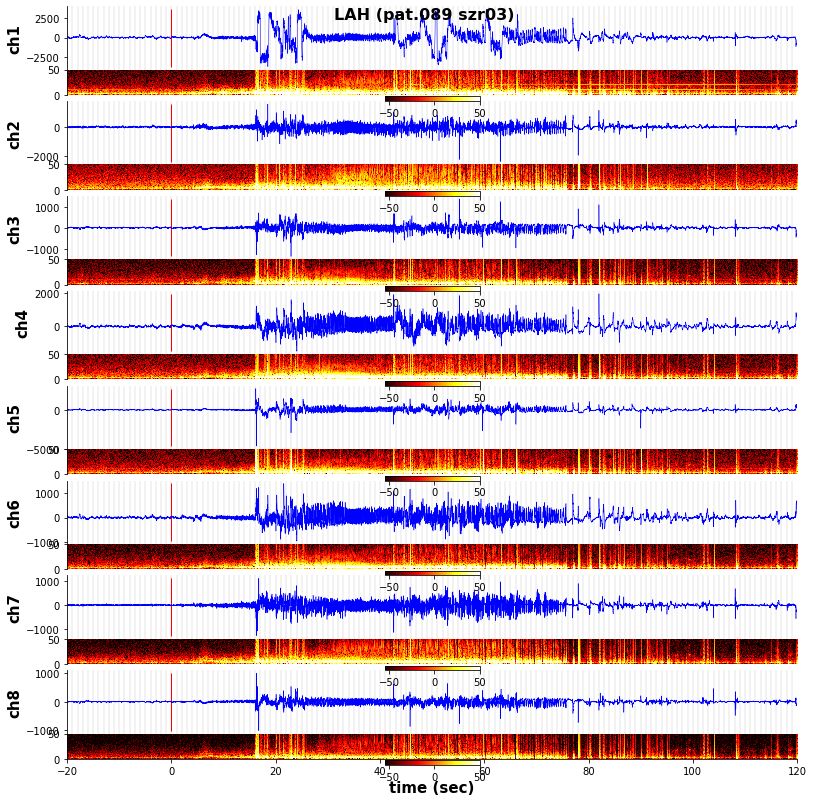

saving plot LEC_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/plots_so_determination


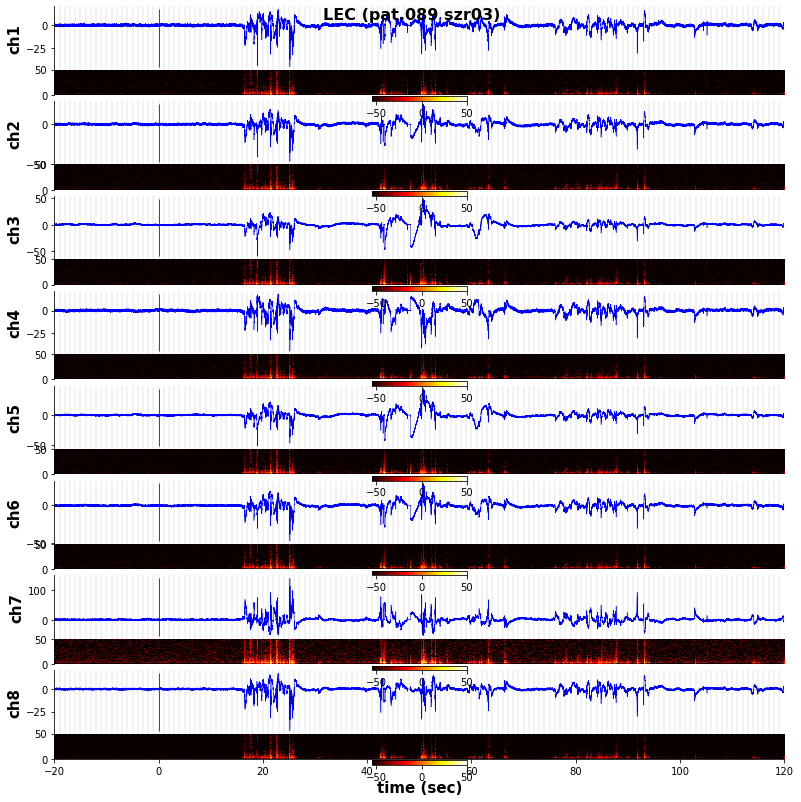

saving plot LMH_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/plots_so_determination


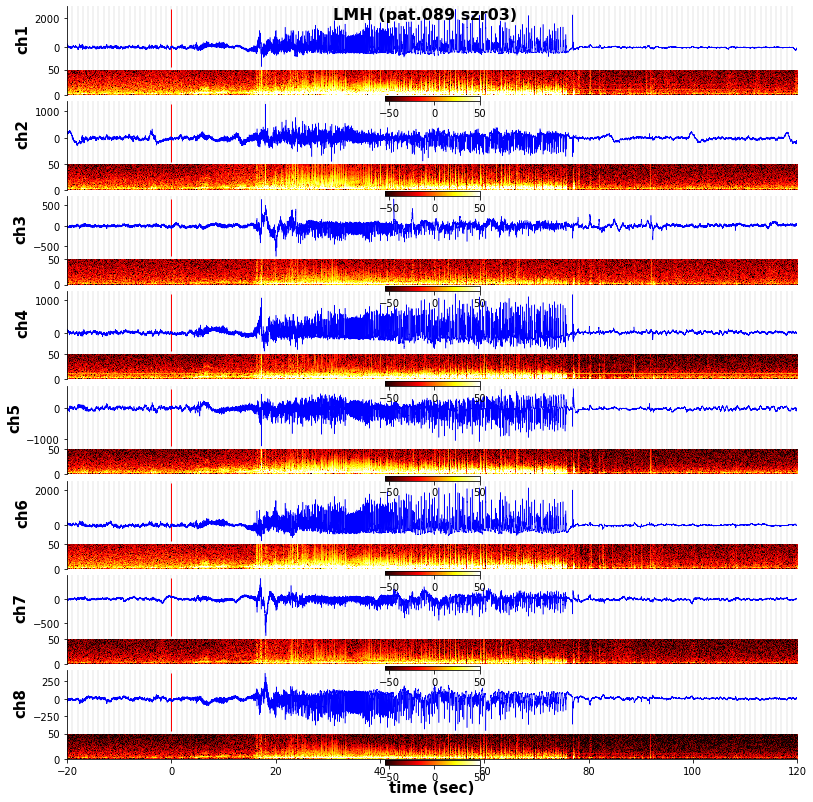

saving plot LPHC_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/plots_so_determination


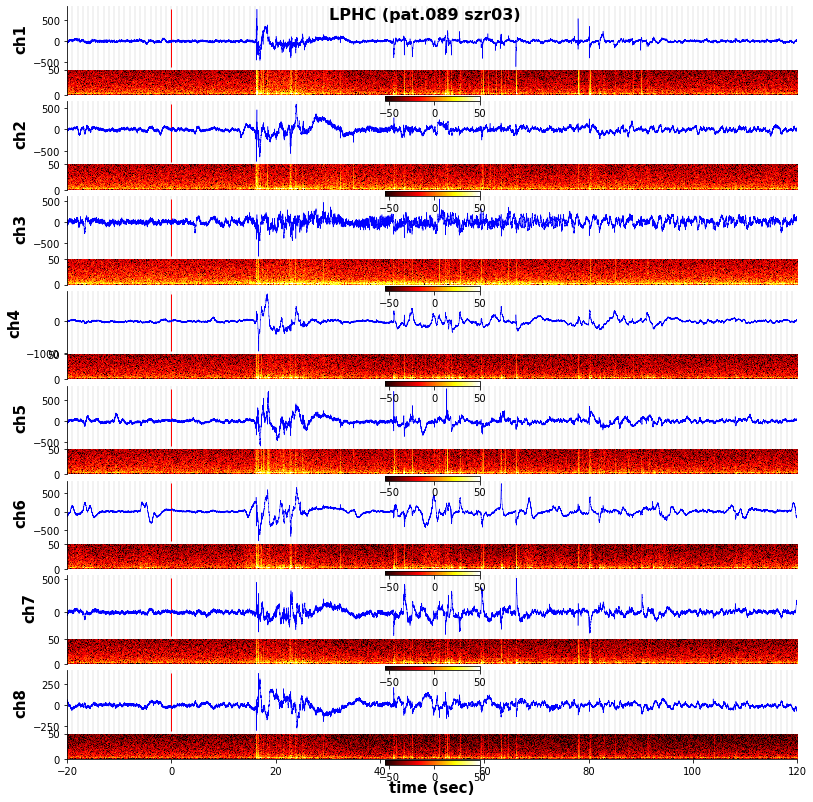

saving plot LPIC_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/plots_so_determination


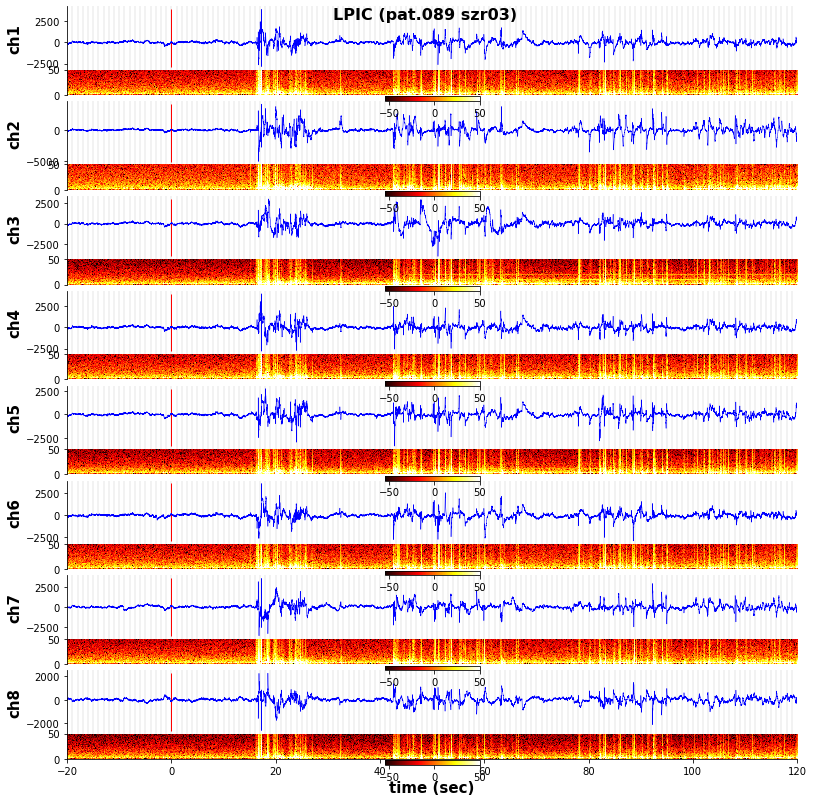

saving plot RA_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/plots_so_determination


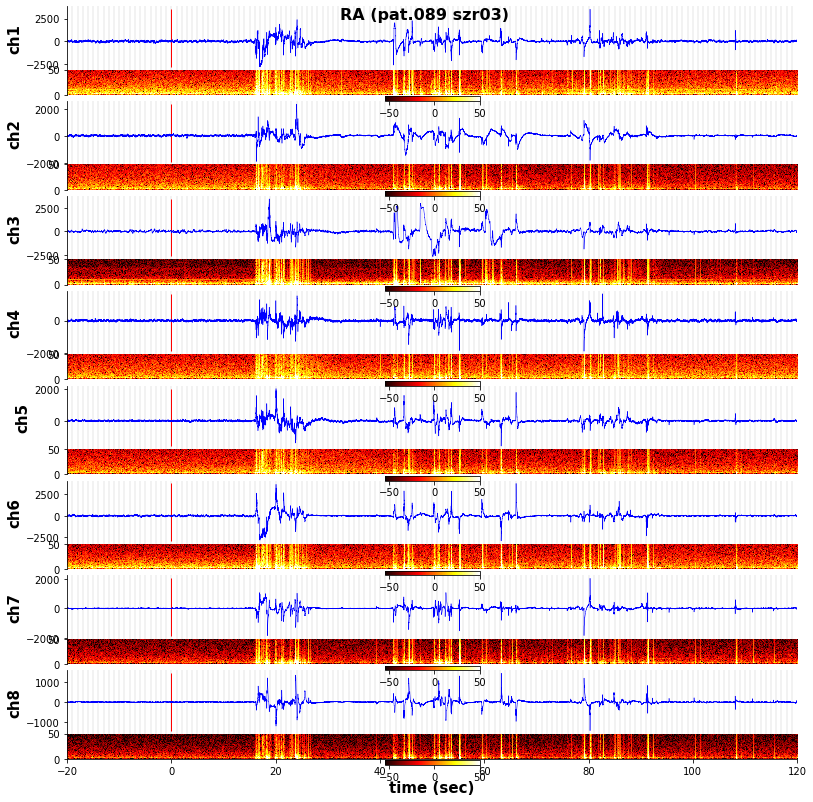

saving plot RAH_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/plots_so_determination


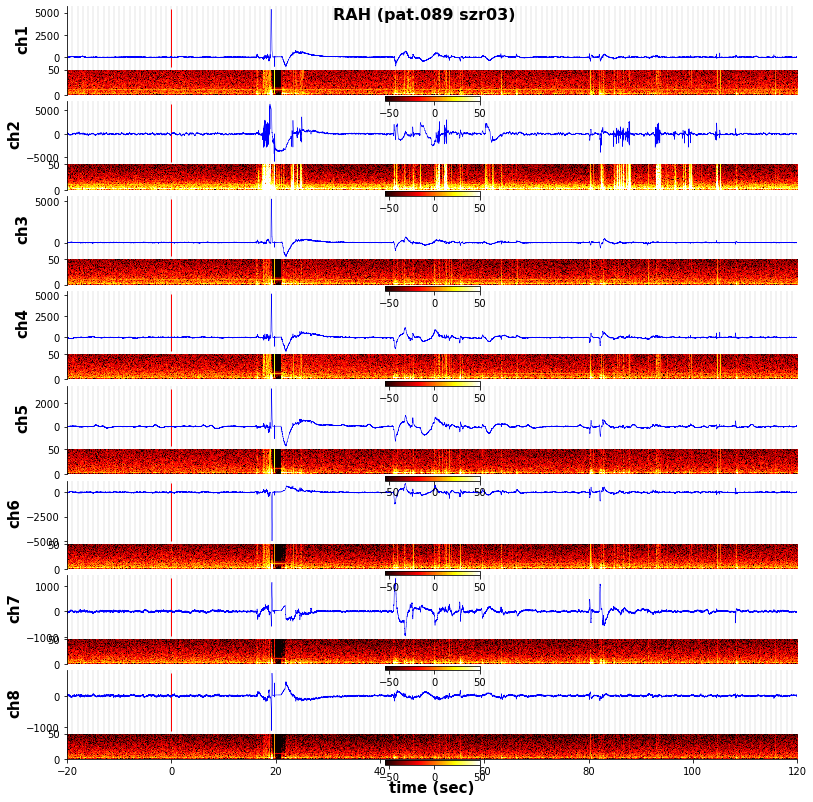

saving plot REC_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/plots_so_determination


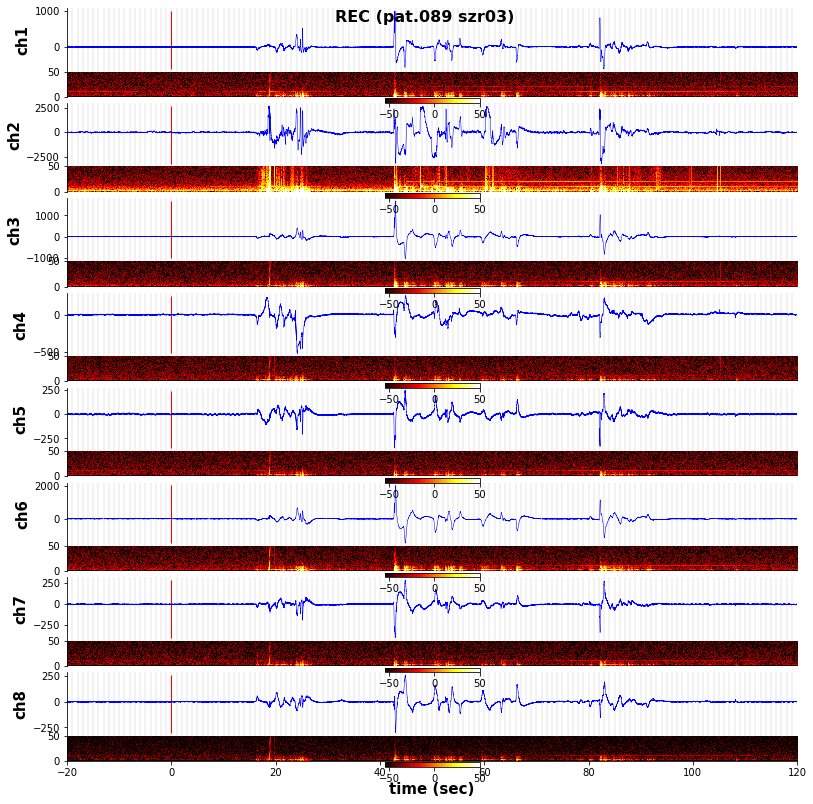

saving plot RMH_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/plots_so_determination


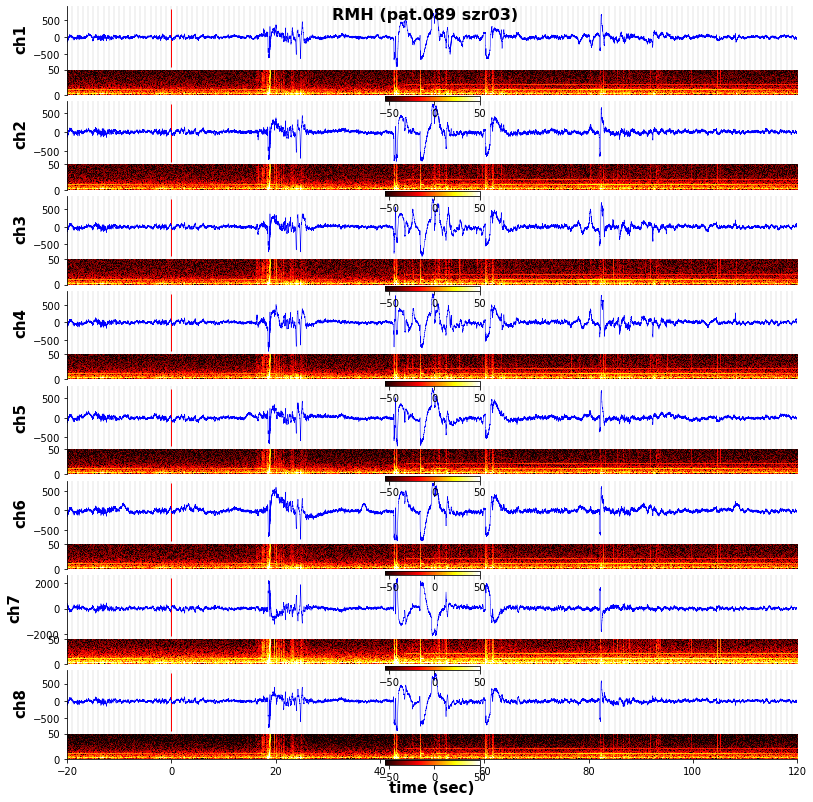

saving plot RPHC_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/plots_so_determination


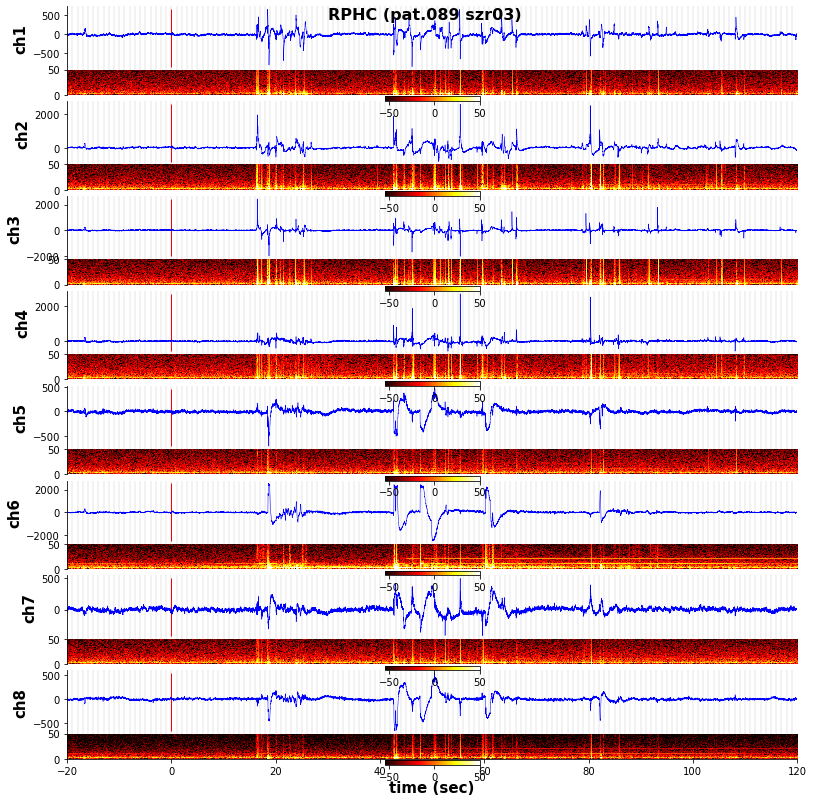

saving plot RPIC_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/plots_so_determination


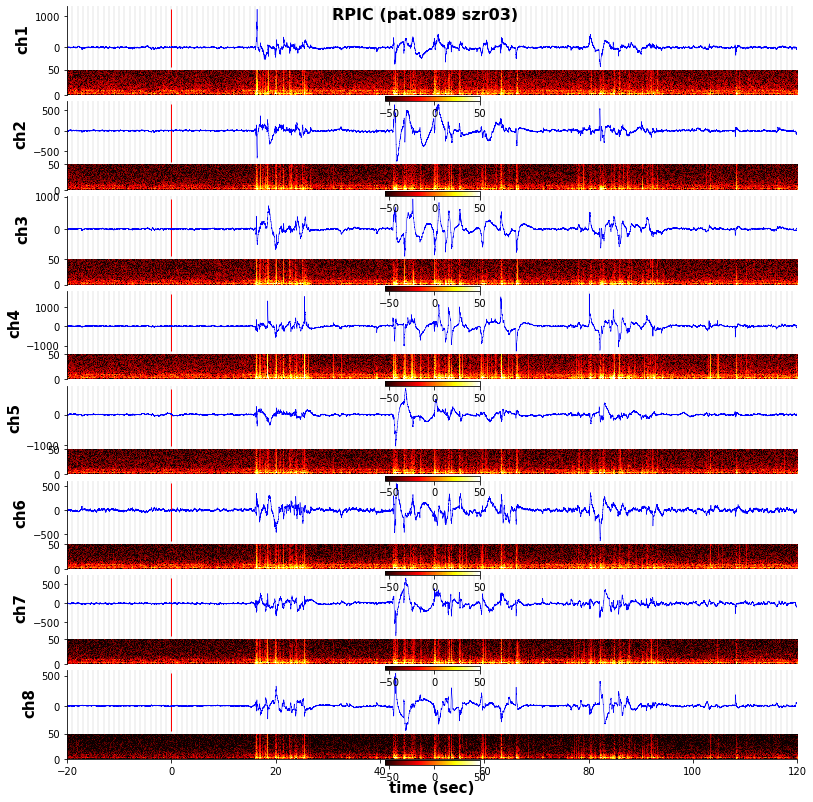

creating path for saving: /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/macro/plots_so_determination
saving plot AHL_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/macro/plots_so_determination


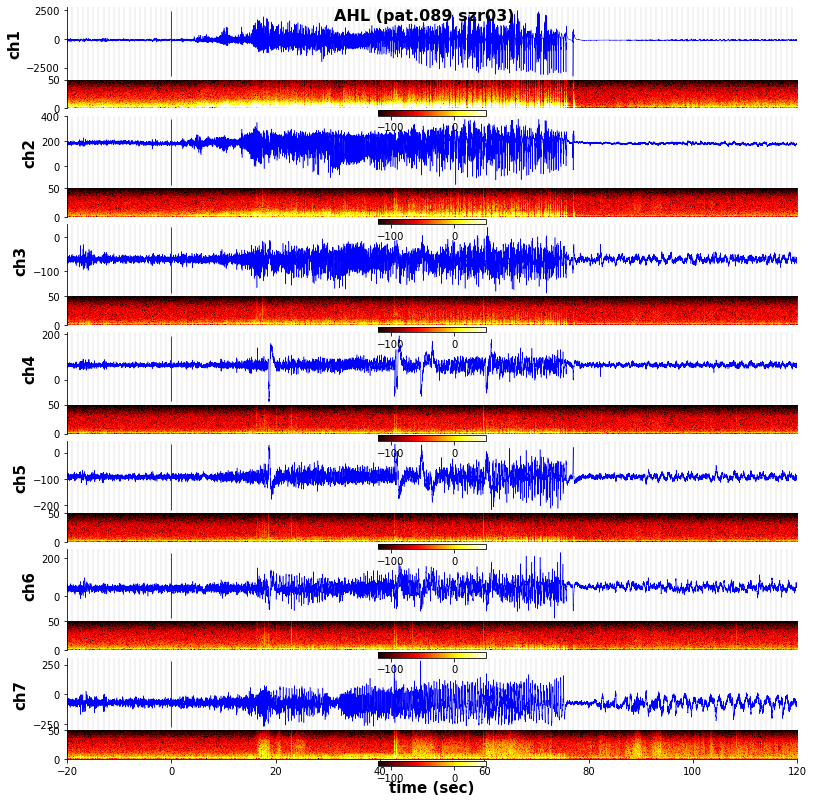

saving plot AHR_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/macro/plots_so_determination


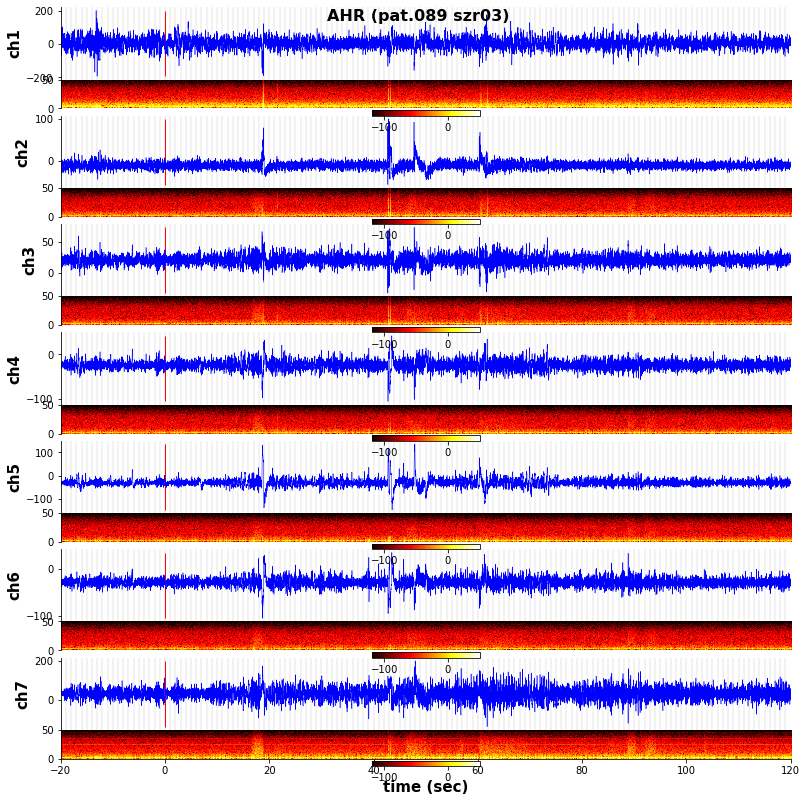

saving plot AL_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/macro/plots_so_determination


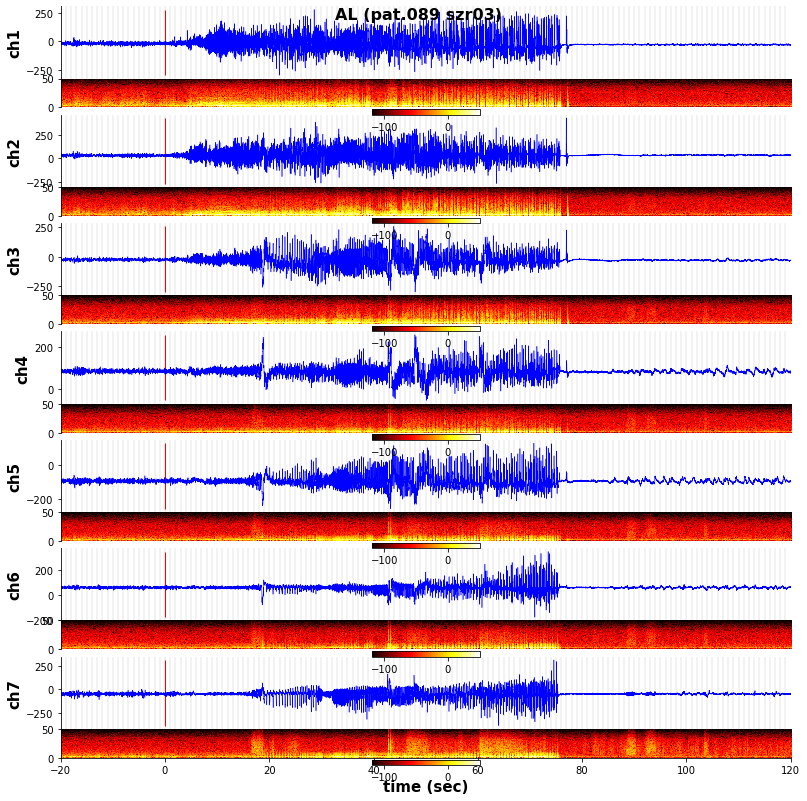

saving plot AR_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/macro/plots_so_determination


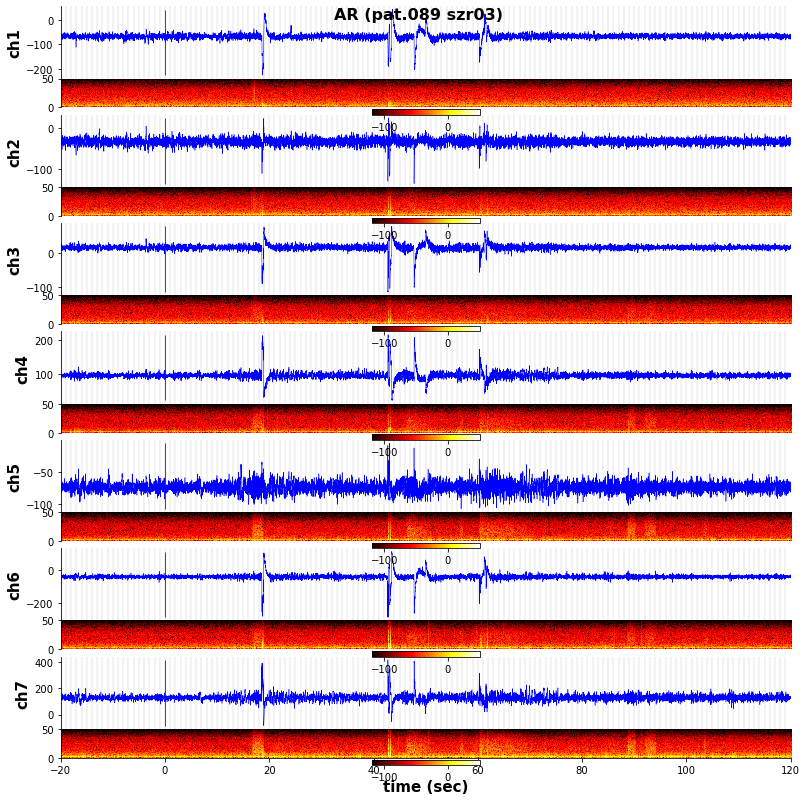

saving plot ECL_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/macro/plots_so_determination


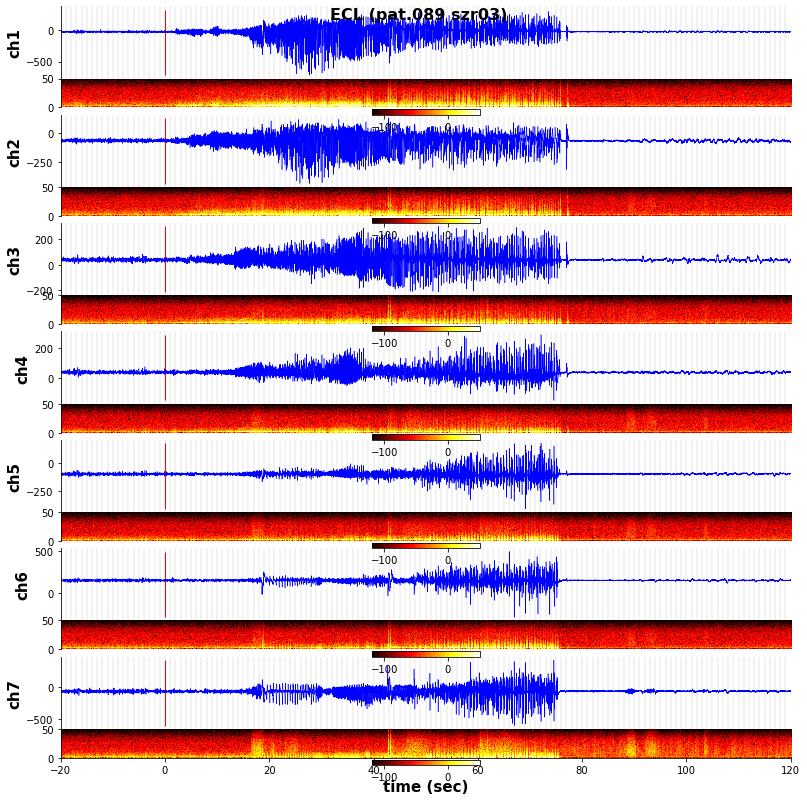

saving plot ECR_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/macro/plots_so_determination


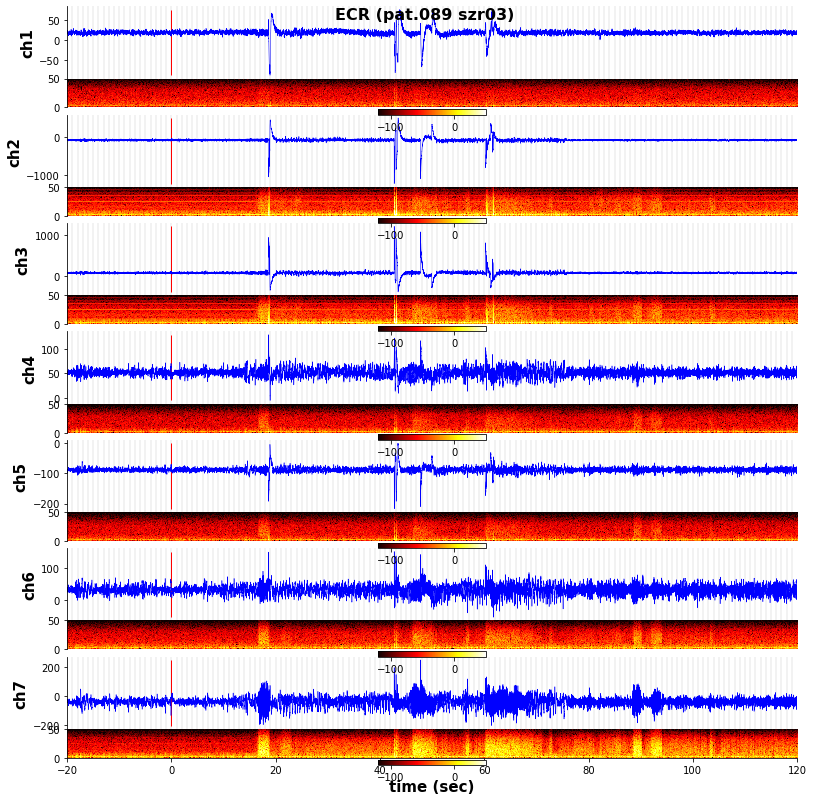

saving plot MHL_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/macro/plots_so_determination


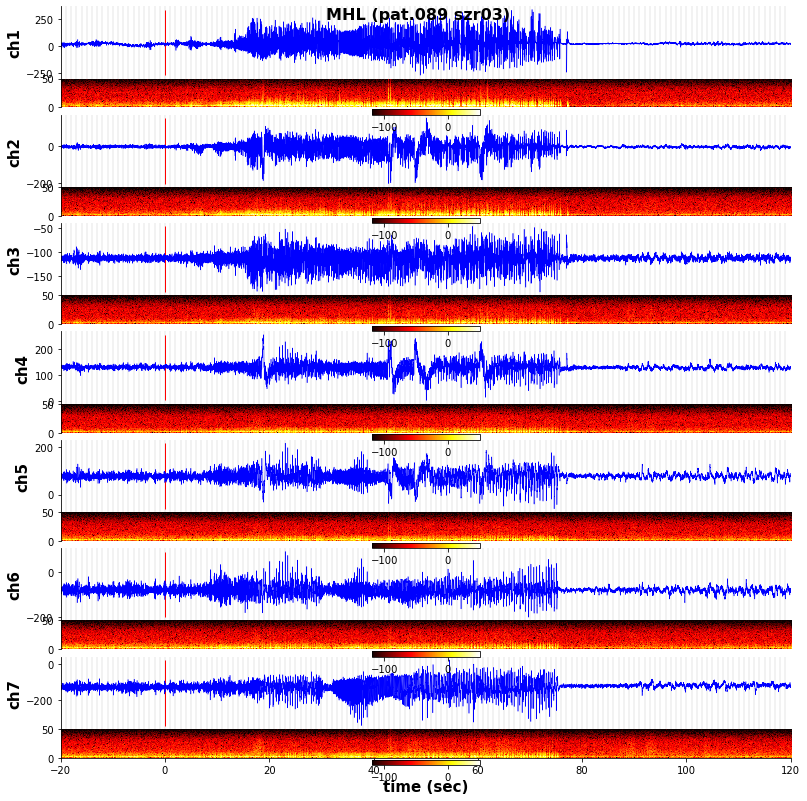

saving plot MHR_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/macro/plots_so_determination


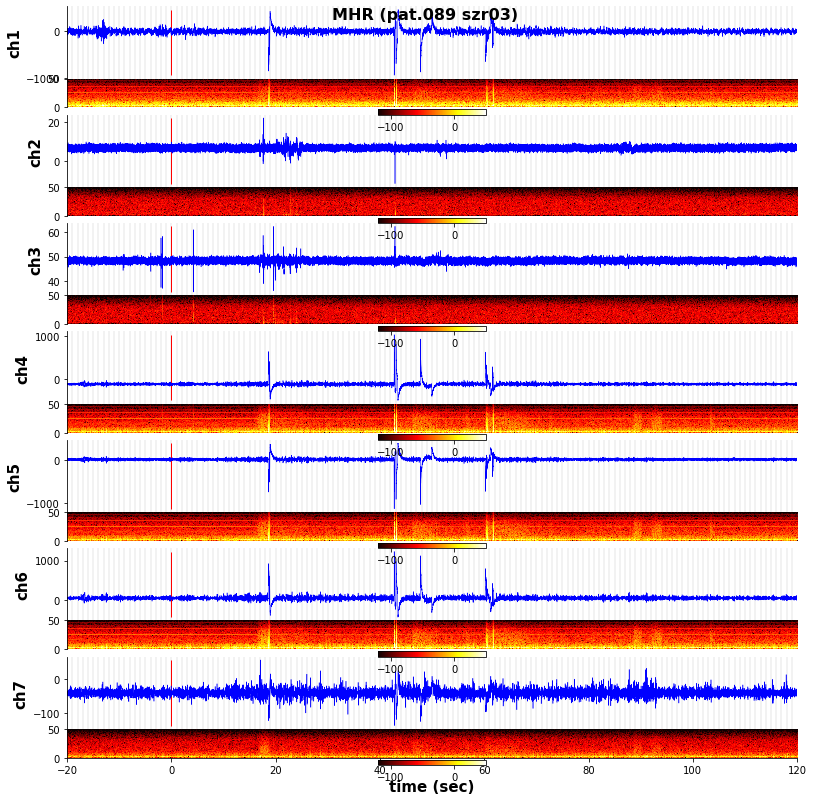

saving plot PHCL_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/macro/plots_so_determination


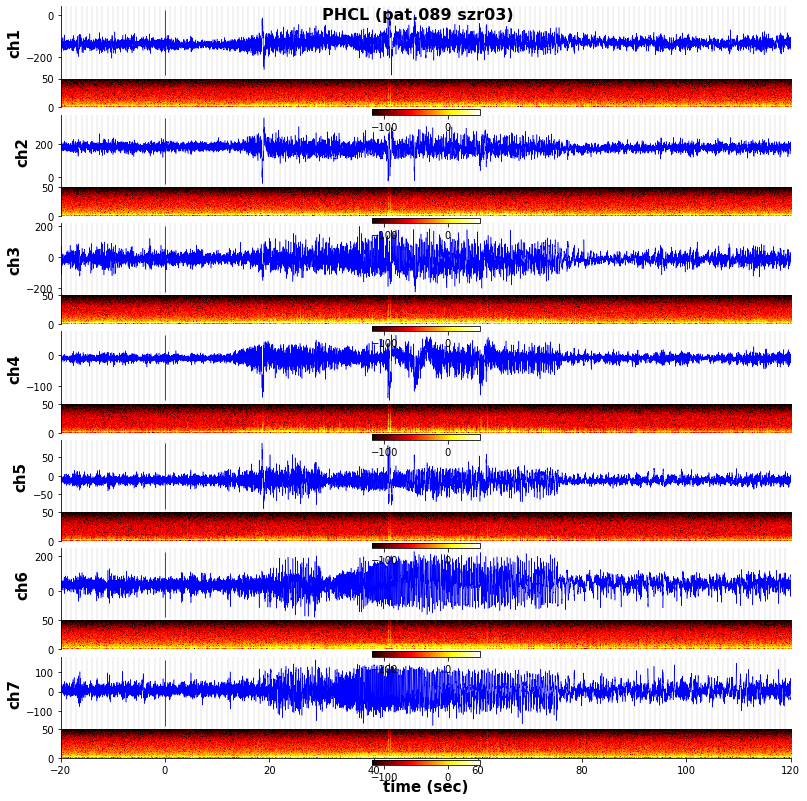

saving plot PHCR_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/macro/plots_so_determination


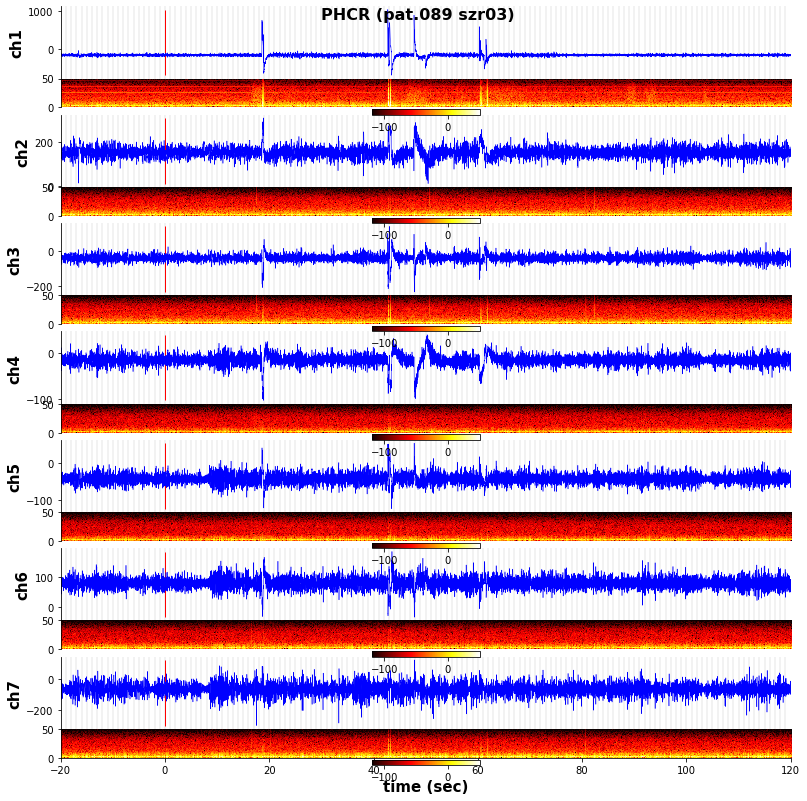

saving plot PICL_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/macro/plots_so_determination


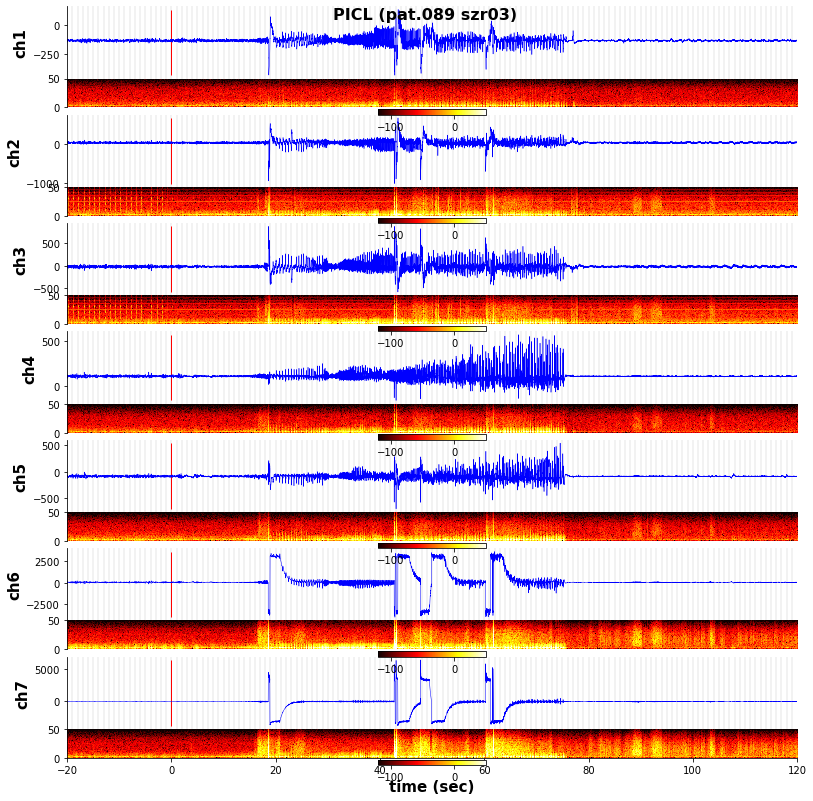

saving plot PICR_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/089_03/seizure_onset_plots/macro/plots_so_determination


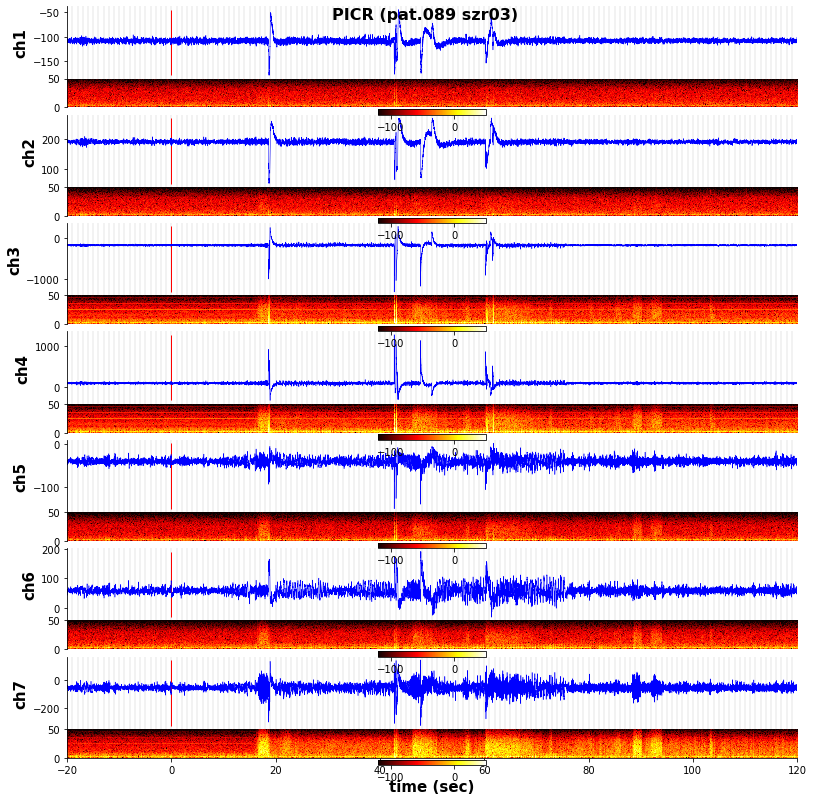

In [125]:
#path = '/media/Seizures/60min_cut/100/2023-04-22_00-10-43/'
#macropath = os.path.join(path, 'macro')
#outpath_base = '/media/Seizures/Wenzel/sd_determination_plots/'
#dframe_outpath = '/media/Seizures/Wenzel/dataframes_patpool'
#pnr, sznr = get_patinfo_from_path(path)
#fname = f'patdata_{pnr}_{sznr}.pkl'
#outpath =  os.path.join(outpath_base, pnr+'_'+sznr)
#outpath_macro = os.path.join(outpath, 'macro')
#sosec = 30*60
#sf=1000


save=True
sosec = 30*60
sf=1000
#s_before = 20
#s_after = 120
fmax = 50

#plot all plots
plot_determine_onset_regions(path, 
                             so_sec=sosec, 
                             sf=sf, 
                             sec_before=20, 
                             sec_after=120, 
                             fmin=0, 
                             fmax=fmax, 
                             plot_filt=False, 
                             region_list=None, 
                             figlabel=None, 
                             save=save, 
                             savepath=plt_spath,
                            spec_vmin=(-fmax)-5,
                            spec_vmax = fmax)

plot_determine_onset_regions(macropath, 
                             so_sec=sosec, 
                             sf=2000, 
                             sec_before=20, 
                             sec_after=120, 
                             fmin=0, 
                             fmax=fmax, 
                             plot_filt=False,
                             region_list=None,
                             figlabel=None,
                             save=save, 
                             savepath=plt_spath_macro,
                            spec_vmin=-(fmax*2)-20,
                            spec_vmax=fmax)

# 3) Plot region of interest, possibly with modified SO

In [149]:
#loading data 
load_df = pd.read_pickle(os.path.join(dframe_outpath, fname))
regions = load_df['region'].unique().tolist()
regions_dic = {i:x for i,x in enumerate(regions)}
print('regions:\n',regions_dic)

regions:
 {0: 'LA', 1: 'LAH', 2: 'LEC', 3: 'LMH', 4: 'LPHC', 5: 'LPIC', 6: 'LTa', 7: 'LTb'}


In [173]:
#Change for plotting or saving df
plot=True
save_df =True
save_plt = True
reg = 'LMH'
delta_sec = 0
#newval = 1800+ delta_sec
duration = 71

sosec = 30*60
newso = sosec+delta_sec
new_prediction = newso+duration


#duration = False
#plot region of interest
roi = [reg] if type(reg)==str else [regions_dic[reg]]
roi_macro = from_micro_to_macro_names(roi)
roi_str = roi[0]
load_df[load_df['region']==roi_str]

,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_sec,fname,SO_index,seizureinvaded,sdinvaded_region,sdinvaded_ch,sdend_sec,sdonset_sec,seizuretermination_sec
24,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LMH1,LMH,L,1000,1800,CSC25.ncs,1800000.0,1.0,0,1.0,1879,1871,1874
25,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LMH2,LMH,L,1000,1800,CSC26.ncs,1800000.0,1.0,0,1.0,1879,1871,1874
26,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LMH3,LMH,L,1000,1800,CSC27.ncs,1800000.0,1.0,0,0.0,1879,,1874
27,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LMH4,LMH,L,1000,1800,CSC28.ncs,1800000.0,1.0,0,1.0,1879,1871,1874
28,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LMH5,LMH,L,1000,1800,CSC29.ncs,1800000.0,1.0,0,0.0,1879,,1874
29,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LMH6,LMH,L,1000,1800,CSC30.ncs,1800000.0,1.0,0,0.0,1879,,1874
30,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LMH7,LMH,L,1000,1800,CSC31.ncs,1800000.0,1.0,0,1.0,1879,1871,1874
31,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LMH8,LMH,L,1000,1800,CSC32.ncs,1800000.0,1.0,0,0.0,1879,,1874


saving plot LMH_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/092_03/seizure_onset_plots/plots_so_determination


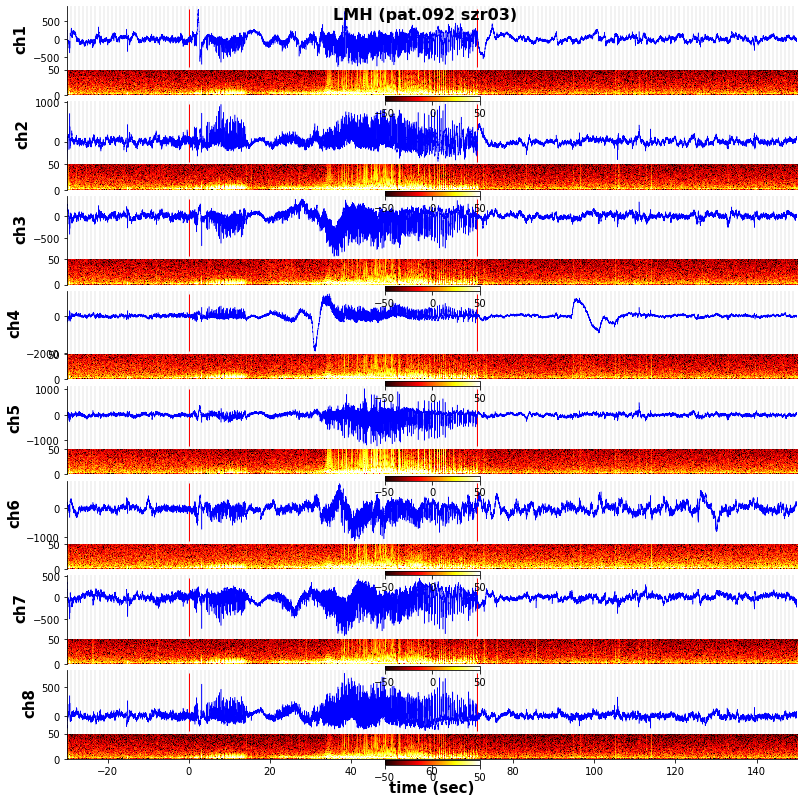

saving plot MHL_so_determiation in /media/Seizures/Wenzel/sd_determination_plots/092_03/seizure_onset_plots/macro/plots_so_determination


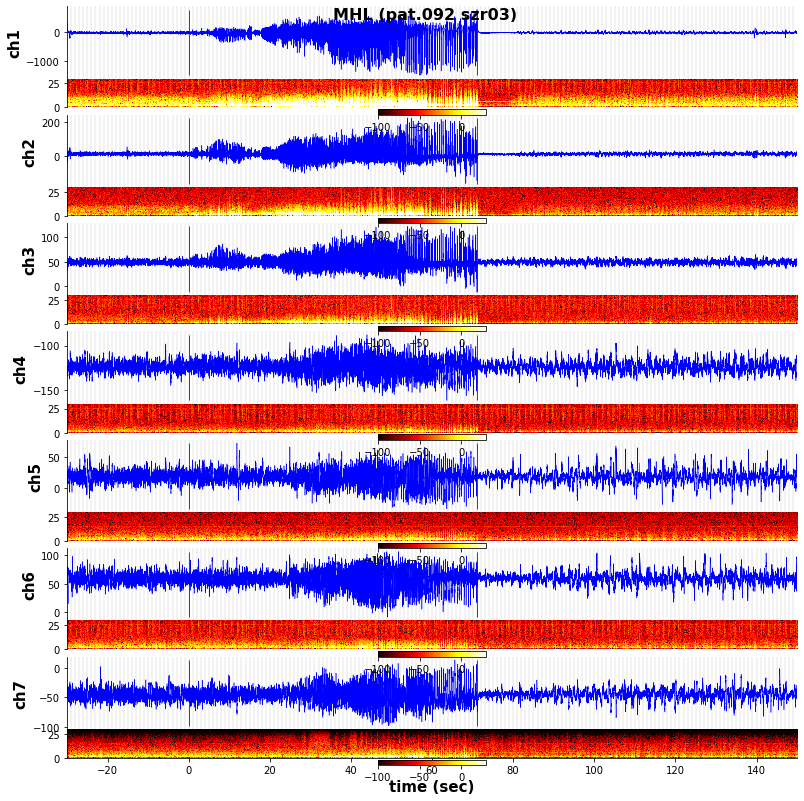

,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_sec,fname,SO_index,seizureinvaded,sdinvaded_region,sdinvaded_ch,sdend_sec,sdonset_sec,seizuretermination_sec
24,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LMH1,LMH,L,1000,1800,CSC25.ncs,1800000.0,1.0,0,1.0,1879,1871,1874
25,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LMH2,LMH,L,1000,1800,CSC26.ncs,1800000.0,1.0,0,1.0,1879,1871,1874
26,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LMH3,LMH,L,1000,1800,CSC27.ncs,1800000.0,1.0,0,0.0,1879,,1874
27,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LMH4,LMH,L,1000,1800,CSC28.ncs,1800000.0,1.0,0,1.0,1879,1871,1874
28,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LMH5,LMH,L,1000,1800,CSC29.ncs,1800000.0,1.0,0,0.0,1879,,1874
29,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LMH6,LMH,L,1000,1800,CSC30.ncs,1800000.0,1.0,0,0.0,1879,,1874
30,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LMH7,LMH,L,1000,1800,CSC31.ncs,1800000.0,1.0,0,1.0,1879,1871,1874
31,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LMH8,LMH,L,1000,1800,CSC32.ncs,1800000.0,1.0,0,0.0,1879,,1874


In [174]:

#delta_sec = 0

#plot params
sf=1000
s_before = (1*60)-30
s_after = (2*60)+30
fmax = 50
fmax_macro = 30 #

vmin = -50


if plot:
    plot_determine_onset_regions(path, 
                                 so_sec=newso, 
                                 sf=sf, 
                                 sec_before=s_before, 
                                 sec_after=s_after, 
                                 fmin=0, 
                                 fmax=fmax, 
                                 plot_filt=False, 
                                 region_list=roi, 
                                 figlabel=None, 
                                 save=save_plt, 
                                 savepath=plt_spath,
                                 duration_sec=duration,
                                spec_vmin=vmin,
                                spec_vmax=fmax)
     
    plot_determine_onset_regions(macropath, 
                                 so_sec=newso, 
                                 sf=2000, 
                                 sec_before=s_before, 
                                 sec_after=s_after, 
                                 fmin=0, 
                                 fmax=fmax_macro, 
                                 plot_filt=False, 
                                 region_list=roi_macro,
                                 figlabel=None, 
                                 save=save_plt, 
                                 savepath=plt_spath_macro,
                                 duration_sec=duration,
                                spec_vmin=(vmin)*2,
                                spec_vmax=fmax_macro)




#curr_idx = load_df['SO_sec'][load_df['region']==roi_str].index.tolist()  
#curr_val = load_df['SO_sec'][curr_idx].tolist()
#new_val = [newval]* len(curr_val)
#chnames_in_reg = load_df[load_df['region']==roi_str]['chname'].tolist()

#if new_val != curr_val:
#    print('new value:', newval)
#    
#    if save_df:
#        modifyValueToDataframe(load_df, val=newval, col='SO_sec', key=chnames_in_reg, key_col='chname')
#        load_df.to_pickle(os.path.join(dframe_outpath, fname))
#
#else:
#    print('no_modification')
#load_df.to_pickle(os.path.join(dframe_outpath, fname))
load_df[load_df['region']==roi_str]

In [169]:
if save_df:
    print('saving dataframe')
    #modify SO_sec
    roi_str=roi[0]
    curr_idx = load_df['SO_sec'][load_df['region']==roi_str].index.tolist()
    curr_val = load_df['SO_sec'][curr_idx].tolist()
    mean_cv = int(np.nanmean(curr_val))
    chnames_in_reg = load_df[load_df['region']==roi_str]['chname'].tolist()#
    #original_prediction = 1800
    #new_prediction = mean_cv + delta_sec
    
    if not mean_cv == newso: #if value is different than already reported
        #new_val = [c + delta_sec for c in curr_val]
        modifyValueToDataframe(load_df, val=newso, col='SO_sec', 
                               key=chnames_in_reg, key_col='chname')###
        print('seizure onset time set to:', mean_cv, newso)
    else:
        print('seizure onset time remains unchanged:', mean_cv, newso)
    
    if duration:
        #check if value exists:
        if 'seizuretermination_sec' in load_df.keys():
            old_duration = np.nanmean(
                pd.to_numeric(load_df['seizuretermination_sec'][curr_idx].tolist(), errors='coerce'))
            
            if not old_duration == new_prediction:
                print('duration of seizure changed from ', old_duration, 'to:', new_prediction)
                modifyValueToDataframe(load_df, val=new_prediction, col='seizuretermination_sec', 
                                       key=chnames_in_reg, key_col='chname')
            else:
                print('duration of seizure remained unchanged:', old_duration, new_prediction)
        else:
            print('duration of seizure set to:', mean_cv+duration)
            modifyValueToDataframe(load_df, val=mean_cv+duration, col='seizuretermination_sec', 
                                       key=chnames_in_reg, key_col='chname')
    #save
    load_df.to_pickle(os.path.join(dframe_outpath, fname))
    load_df = pd.read_pickle(os.path.join(dframe_outpath, fname))
load_df[load_df['region']==roi_str]

saving dataframe
seizure onset time remains unchanged: 1800 1800
duration of seizure changed from  nan to: 1871


/tmp/ipykernel_826716/911036423.py:23: RuntimeWarning: Mean of empty slice
  old_duration = np.nanmean(


,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_sec,fname,SO_index,seizureinvaded,sdinvaded_region,sdinvaded_ch,sdend_sec,sdonset_sec,seizuretermination_sec
8,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LAH1,LAH,L,1000,1800,CSC9.ncs,1800000.0,1.0,1,1.0,1878,1871,1871
9,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LAH2,LAH,L,1000,1800,CSC10.ncs,1800000.0,1.0,1,1.0,1878,1871,1871
10,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LAH3,LAH,L,1000,1800,CSC11.ncs,1800000.0,1.0,1,0.0,1878,,1871
11,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LAH4,LAH,L,1000,1800,CSC12.ncs,1800000.0,1.0,1,0.0,1878,,1871
12,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LAH5,LAH,L,1000,1800,CSC13.ncs,1800000.0,1.0,1,1.0,1878,1871,1871
13,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LAH6,LAH,L,1000,1800,CSC14.ncs,1800000.0,1.0,1,1.0,1878,1871,1871
14,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LAH7,LAH,L,1000,1800,CSC15.ncs,1800000.0,1.0,1,0.0,1878,,1871
15,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LAH8,LAH,L,1000,1800,CSC16.ncs,1800000.0,1.0,1,0.0,1878,,1871


In [4]:
def plotObject(nrRows=1, nrCols=1, nrSubjects=1, height_ratios=False, myDpi=92, lenXax=1900, lenYax=1024, shareX=False, shareY=False):
    '''
    '''
    nr_rows = nrRows*nrSubjects
    
    fig, axs = plt.subplots(nr_rows, nrCols, figsize=(lenXax/myDpi, lenYax/myDpi), sharex=shareX, sharey=shareY)
    if height_ratios:
        #print(hight_rations*nr_rows, nr_rows)
        gs = gridspec.GridSpec(nr_rows, nrCols, height_ratios=height_ratios*nrSubjects)
    else:
        gs = gridspec.GridSpec(nr_rows, nrCols)
    spines = ('top', 'right', 'bottom')
    
    for i in range(nr_rows):
        #if nr_rows==1:
        #    cur_ax = axs
        #else:
        #    curr_ax = axs[i]
        axs[i] = plt.subplot(gs[i])
        for sp in spines: 
            axs[i].spines[sp].set_visible(False)
        axs[i].tick_params(bottom=False, labelbottom=False)
    axs[i].spines[sp].set_visible(True)
    axs[i].tick_params(bottom=True, labelbottom=True)
    #remove spines
   
    fig.tight_layout()
    fig.subplots_adjust(hspace=.0)
    #fig.tight_layout()
    #plt.show()
    return fig, axs


/media/Seizures/60min_cut/081/2019-12-11_17-55-33/DS_data/reref CSC1.ncs
/media/Seizures/60min_cut/081/2019-12-11_17-55-33/DS_data/reref CSC2.ncs
/media/Seizures/60min_cut/081/2019-12-11_17-55-33/DS_data/reref CSC3.ncs
/media/Seizures/60min_cut/081/2019-12-11_17-55-33/DS_data/reref CSC4.ncs
/media/Seizures/60min_cut/081/2019-12-11_17-55-33/DS_data/reref CSC5.ncs
/media/Seizures/60min_cut/081/2019-12-11_17-55-33/DS_data/reref CSC6.ncs
/media/Seizures/60min_cut/081/2019-12-11_17-55-33/DS_data/reref CSC7.ncs
/media/Seizures/60min_cut/081/2019-12-11_17-55-33/DS_data/reref CSC8.ncs


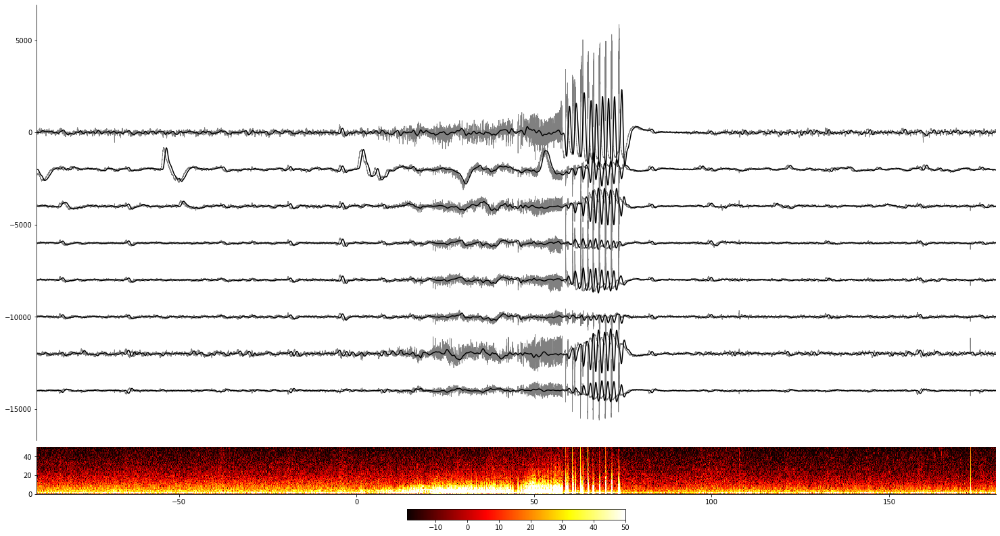

In [7]:
rah_df = load_df[load_df['region']=='RAH']
sec_before = 30+60
sec_after = (2*60)+60
sf = 1000
so_sec = 1800

fmin = 0
fmax = 50

counter = 0

# Create plot with three subplots
fig, ax = plotObject(nrRows=2, nrCols=1, nrSubjects=1, shareX=True, height_ratios=[3,0.5])
data_to_copy = {'chname' : [],
               'data' : [],
               'time_axis': [],
               'sf': []}
for i, ex in rah_df['datapath'].items():
    print(ex, rah_df['fname'][i])
    matfile = readMatfile(os.path.join(ex, f"{rah_df['fname'][i].split('.')[0]}_reref_data"))
    data = matfile.reref_data[(so_sec * sf) - (sec_before * sf):(so_sec * sf) + (sec_after * sf)]
    data_to_copy['chname'].append(rah_df['chname'][i])
    data_to_copy['data'].append(data)
    #_ = butter_lowpass_filter(data, 1, fs=sf, order=5)
    filt = butter_lowpass_filter(data, 0.8, fs=sf, order=5)
    timeax = np.linspace(-sec_before, sec_after, len(data))
    f_axis, t_axis, spg = spectrogram(data, fs=sf, nperseg=200, noverlap=150, scaling='density')
    dbspg = 20 * np.log10(spg[fmin:fmax, ])
    
    if counter == 0:
        mean_spg = dbspg
    else:
        old_spg = mean_spg
        mean_spg = np.asarray([np.nanmean([old_spg[ii], dbspg[ii]], axis=0) for ii, fr in enumerate(dbspg)])
        
    
    ax[0].plot(timeax, (data) - counter*2000, c='gray', linewidth=0.8)
    ax[0].plot(timeax, (filt) - counter*2000, c='k', linewidth=1.5)
        
    counter += 1
    
spec = ax[1].imshow(np.subtract(mean_spg, np.nanmean(mean_spg.flatten())), aspect='auto', cmap='hot', origin='lower',
                    extent=[sec_before * -1, sec_after, fmin, fmax], norm=Normalize(vmin=-19, vmax=fmax, clip=False))

ax[0].set_xlim(min(timeax), max(timeax))
#ax[0].set_yticks([])
#ax[0].spines['left'].set_visible(False)
fig.colorbar(spec, ax=ax[1], orientation='horizontal', pad=0.2)
plt.tight_layout()
plt.show()

data_to_copy['time_axis'].append(timeax)
data_to_copy['sf'].append(sf)

figname = 'RAH_mean_spec'
figformat = 'eps'
savepath= '/media/Seizures/Wenzel/'

figoutname = os.path.join(savepath, '.'.join([figname, figformat]))

#fig.savefig(figoutname,
#            format=figformat,
#            dpi=300,
#            bbox_inches='tight')

In [8]:

savemat('/media/Seizures/Wenzel/RAH_plot_data.mat', data_to_copy, do_compression=True)

In [145]:
data_to_copy

{'chname': ['RAH1', 'RAH2', 'RAH3', 'RAH4', 'RAH5', 'RAH6', 'RAH7', 'RAH8'],
 'data': [array([170.79235054, 172.89687267, 171.8982401 , ..., -36.14819583,
         -34.85732437, -38.97608756]),
  array([-6.56365145, -0.02031197,  3.67185914, ..., 12.93584934,
         13.91769839,  9.97297945]),
  array([ -6.65954864,  -4.11965151, -10.75655279, ..., -67.18675372,
         -69.26444785, -76.04925813]),
  array([45.41161459, 51.2372364 , 52.68321268, ..., 24.20522905,
         19.16403947, 15.42406046]),
  array([54.62436826, 59.26444337, 55.44483445, ..., 38.21210294,
         39.39280152, 32.12843146]),
  array([13.16289601, 14.33966089, 13.66577621, ...,  3.62158226,
          1.92745129,  1.81139241]),
  array([-167.05106657, -162.90429723, -154.84264798, ...,   -8.71838274,
           -8.8368875 ,   -7.96908526]),
  array([68.21057481, 64.68439355, 61.37443431, ..., -0.37326491,
          0.30642392,  1.3813497 ])],
 'time_axis': [array([-30.        , -29.99899999, -29.99799999, ..

In [8]:
load_df[load_df['region']=='RAH']

,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_sec,fname,seizureinvaded,SO_index,sdinvaded_ch,sdonset_sec,sdend_sec,sdinvaded_region,seizuretermination_sec
0,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RAH1,RAH,R,1000,1800,CSC1.ncs,1.0,1800000.0,1,1874,1882,1,
1,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RAH2,RAH,R,1000,1800,CSC2.ncs,1.0,1800000.0,,,1882,1,
2,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RAH3,RAH,R,1000,1800,CSC3.ncs,1.0,1800000.0,1,1874,1882,1,
3,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RAH4,RAH,R,1000,1800,CSC4.ncs,1.0,1800000.0,,,1882,1,
4,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RAH5,RAH,R,1000,1800,CSC5.ncs,1.0,1800000.0,,,1882,1,
5,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RAH6,RAH,R,1000,1800,CSC6.ncs,1.0,1800000.0,,,1882,1,
6,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RAH7,RAH,R,1000,1800,CSC7.ncs,1.0,1800000.0,1,1874,1882,1,
7,081,03,/media/Seizures/60min_cut/081/2019-12-11_17-55...,RAH8,RAH,R,1000,1800,CSC8.ncs,1.0,1800000.0,,,1882,1,


In [78]:
pd.to_numeric(load_df['seizuretermination_sec'][curr_idx].tolist(), errors='coerce')

array([nan, nan, nan, nan, nan, nan, nan, nan])

In [360]:
load_df.to_pickle(os.path.join(dframe_outpath, fname))
roi = [reg] if type(reg)==str else [regions_dic[reg]]
roi_str=roi[0]
load_df[load_df['region']==roi_str]

,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_sec,fname,seizureinvaded,seizuretermination_sec
48,074,01,/media/Seizures/60min_cut/074/2019-06-28_09-15...,RAH1,RAH,R,1000,1861,CSC49.ncs,1,1926
49,074,01,/media/Seizures/60min_cut/074/2019-06-28_09-15...,RAH2,RAH,R,1000,1861,CSC50.ncs,1,1926
50,074,01,/media/Seizures/60min_cut/074/2019-06-28_09-15...,RAH3,RAH,R,1000,1861,CSC51.ncs,1,1926
51,074,01,/media/Seizures/60min_cut/074/2019-06-28_09-15...,RAH4,RAH,R,1000,1861,CSC52.ncs,1,1926
52,074,01,/media/Seizures/60min_cut/074/2019-06-28_09-15...,RAH5,RAH,R,1000,1861,CSC53.ncs,1,1926
53,074,01,/media/Seizures/60min_cut/074/2019-06-28_09-15...,RAH6,RAH,R,1000,1861,CSC54.ncs,1,1926
54,074,01,/media/Seizures/60min_cut/074/2019-06-28_09-15...,RAH7,RAH,R,1000,1861,CSC55.ncs,1,1926
55,074,01,/media/Seizures/60min_cut/074/2019-06-28_09-15...,RAH8,RAH,R,1000,1861,CSC56.ncs,1,1926


# 4) Remove region from seizure invaded

In [63]:
#loading data 
load_df = pd.read_pickle(os.path.join(dframe_outpath, fname))
regions = load_df['region'].unique().tolist()
regions_dic = {i:x for i,x in enumerate(regions)}
print('regions:\n',regions_dic)

regions:
 {0: 'LA', 1: 'LAH', 2: 'LEC', 3: 'LMH', 4: 'LPHC', 5: 'LPIC', 6: 'RA', 7: 'RAH', 8: 'REC', 9: 'RMH', 10: 'RPHC', 11: 'RPIC'}


In [185]:
#modify seizureinvaded
value=0
reg_ = 'RPIC'
if not 'reg' in locals() or reg_ is not None:
    reg = reg_

roi = [reg] if type(reg)==str else [regions_dic[reg]]
#roi = [regions_dic[i] for i in range(len(regions_dic.keys()))]
print(roi)
#curr_idx = load_df['seizureinvaded'][load_df['region']==roi[0]].index.tolist()
chnames_in_reg = load_df[load_df['region']==roi[0]]['chname'].tolist()


modifyValueToDataframe(load_df, val=value, col='seizureinvaded', key=chnames_in_reg, key_col='chname')
load_df.to_pickle(os.path.join(dframe_outpath, fname))
reg_=None
load_df[load_df['region']==roi[0]]

['RPIC']


,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_sec,fname,seizureinvaded,seizuretermination_sec
88,089,03,/media/Seizures/60min_cut/089/2021-04-26_00-00...,RPIC1,RPIC,R,1000,1800,CSC89.ncs,0,
89,089,03,/media/Seizures/60min_cut/089/2021-04-26_00-00...,RPIC2,RPIC,R,1000,1800,CSC90.ncs,0,
90,089,03,/media/Seizures/60min_cut/089/2021-04-26_00-00...,RPIC3,RPIC,R,1000,1800,CSC91.ncs,0,
91,089,03,/media/Seizures/60min_cut/089/2021-04-26_00-00...,RPIC4,RPIC,R,1000,1800,CSC92.ncs,0,
92,089,03,/media/Seizures/60min_cut/089/2021-04-26_00-00...,RPIC5,RPIC,R,1000,1800,CSC93.ncs,0,
93,089,03,/media/Seizures/60min_cut/089/2021-04-26_00-00...,RPIC6,RPIC,R,1000,1800,CSC94.ncs,0,
94,089,03,/media/Seizures/60min_cut/089/2021-04-26_00-00...,RPIC7,RPIC,R,1000,1800,CSC95.ncs,0,
95,089,03,/media/Seizures/60min_cut/089/2021-04-26_00-00...,RPIC8,RPIC,R,1000,1800,CSC96.ncs,0,


In [199]:
load_df = pd.read_pickle(os.path.join(dframe_outpath, fname))
load_df[load_df['seizureinvaded']==1]

,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_sec,fname,seizureinvaded,sdinvaded_ch,sdonset_sec,sdend_sec,sdinvaded_region,seizuretermination_sec
0,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,LA1,LA,L,1000,1800,CSC1.ncs,1,1,1856,1860,1,
1,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,LA2,LA,L,1000,1800,CSC2.ncs,1,,,1860,1,
2,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,LA3,LA,L,1000,1800,CSC3.ncs,1,,,1860,1,
3,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,LA4,LA,L,1000,1800,CSC4.ncs,1,,,1860,1,
4,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,LA5,LA,L,1000,1800,CSC5.ncs,1,1,1856,1860,1,
5,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,LA6,LA,L,1000,1800,CSC6.ncs,1,1,1856,1860,1,
6,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,LA7,LA,L,1000,1800,CSC7.ncs,1,,,1860,1,
7,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,LA8,LA,L,1000,1800,CSC8.ncs,1,,,1860,1,
8,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,LAH1,LAH,L,1000,1800,CSC9.ncs,1,,,,,1858
9,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,LAH2,LAH,L,1000,1800,CSC10.ncs,1,,,,,1858


------
------
-----
# Extra stuff

In [14]:
%cd /media/Projects/Adrian/seizureProcessing/
from seizureProcessing.utils.get_directories import *
from seizureProcessing.utils.get_chnames import *
from seizureProcessing.utils.get_patinfo_from_path import *

%cd /media/Projects/Adrian/SD_analysis/

from make_basic_dataframe import *

/media/Projects/Adrian/seizureProcessing
/media/Projects/Adrian/SD_analysis


In [16]:
make_basic_dataframe(path, prep_stage='reref')

,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_sec,fname
0,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,LA1,LA,L,1000,1800,CSC1.ncs
1,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,LA2,LA,L,1000,1800,CSC2.ncs
2,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,LA3,LA,L,1000,1800,CSC3.ncs
3,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,LA4,LA,L,1000,1800,CSC4.ncs
4,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,LA5,LA,L,1000,1800,CSC5.ncs
...,...,...,...,...,...,...,...,...,...
91,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,RPIC4,RPIC,R,1000,1800,CSC92.ncs
92,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,RPIC5,RPIC,R,1000,1800,CSC93.ncs
93,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,RPIC6,RPIC,R,1000,1800,CSC94.ncs
94,089,01,/media/Seizures/60min_cut/089/2021-04-19_03-43...,RPIC7,RPIC,R,1000,1800,CSC95.ncs


In [10]:
#path = '/media/Seizures/60min_cut/100/2023-04-22_00-10-43/'
macropath = os.path.join(path, 'macro')
sosec = 30*60
sf=1000
#outpath = path

#make datatframe for patient
#dataDf = make_basic_dataframe(path, sf=sf, so_sec=sosec)
#modifyValueToDataframe(dataDf, val=1, col='seizureinvaded')
#new_df =  make_basic_dataframe(path)
#new_df = dataDf.drop(['SO_ts', 'SO_index'], axis=1)
#new_df = new_df.reset_index(drop=True)
#new_df = new_df.drop(['index'])
#regnames = new_df['region'].tolist()
regnames = new_df.loc[new_df['region'].drop_duplicates().index.tolist()]['region'].tolist()
new_keys = list(set(load_df.keys().tolist())-set(new_df.keys().tolist()))
#new_keys.remove('SO_index')
regnames, new_keys

(['LA', 'LAH', 'LEC', 'LMH', 'LPHC', 'LPIC', 'LTa', 'LTb'],
 ['ch_with_SD',
  'seizureinvaded',
  'sd_invaded',
  'SO_index',
  'SD_duration_sec',
  'SD_onset_sec'])

In [13]:
#new_keys = list(set(load_df.keys().tolist())-set(new_df.keys().tolist()))
#new_keys.remove('SO_index')
for reg in regnames:
    reg_indices = new_df[new_df['region']==reg].index.tolist()
    #mod_value = load_df[load_df['region']==reg]['SO_sec'][load_df.loc[load_df['region']==reg, 'SO_sec'].index[0]]
    mod_value = 0
    for k in new_keys:
        #new_val = load_df[load_df['region']==reg][k][load_df.loc[load_df['region']==reg, k].index[0]]
        new_val = load_df.at[load_df.loc[load_df['region']==reg, k].index[0], k]
        print(new_val, type(new_val), k)
        #if k not in new_df.keys():
        #    new_df[k] = []
        for i in reg_indices:
            #new_df.loc[i, 'SO_sec']=mod_value
            #print(reg, k, mod_value)
            #if 'SO_sec' in k:
            #    new_df.loc[i, k]=mod_value
            #else:
            #    #print(k, load_df[load_df['region']==reg][k][load_df.loc[load_df['region']==reg, key].index[0]])
            #    new_df.loc[i, k]= new_val
            #    #print(reg, k, new_df.loc[i, k], new_val)
            new_df.loc[i, k]=new_val

 <class 'str'> ch_with_SD
1 <class 'numpy.int64'> seizureinvaded
0 <class 'int'> sd_invaded
1800000 <class 'numpy.int64'> SO_index
 <class 'str'> SD_duration_sec
 <class 'str'> SD_onset_sec
CSC9_reref_data.mat,CSC10_reref_data.mat,CSC13_reref_data.mat,CSC14_reref_data.mat <class 'str'> ch_with_SD
1 <class 'numpy.int64'> seizureinvaded
1 <class 'int'> sd_invaded
1800000 <class 'numpy.int64'> SO_index
1878 <class 'int'> SD_duration_sec
1871 <class 'int'> SD_onset_sec
 <class 'str'> ch_with_SD
1 <class 'numpy.int64'> seizureinvaded
0 <class 'int'> sd_invaded
1800000 <class 'numpy.int64'> SO_index
 <class 'str'> SD_duration_sec
 <class 'str'> SD_onset_sec
CSC25_reref_data.mat,CSC26_reref_data.mat,CSC28_reref_data.mat,CSC31_reref_data.mat <class 'str'> ch_with_SD
1 <class 'numpy.int64'> seizureinvaded
1 <class 'int'> sd_invaded
1800000 <class 'numpy.int64'> SO_index
1878 <class 'int'> SD_duration_sec
1871 <class 'int'> SD_onset_sec
 <class 'str'> ch_with_SD
0 <class 'numpy.int64'> seizurein

In [223]:
load_df['region']==reg, k].index[0], load_df.at[[load_df['region']==reg, k].index[0], k]

SyntaxError: unmatched ']' (2151016761.py, line 1)

In [14]:
new_df

,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_sec,fname,ch_with_SD,seizureinvaded,sd_invaded,SO_index,SD_duration_sec,SD_onset_sec
0,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA1,LA,L,1000,1800,CSC1.ncs,,1.0,0.0,1800000.0,,
1,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA2,LA,L,1000,1800,CSC2.ncs,,1.0,0.0,1800000.0,,
2,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA3,LA,L,1000,1800,CSC3.ncs,,1.0,0.0,1800000.0,,
3,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA4,LA,L,1000,1800,CSC4.ncs,,1.0,0.0,1800000.0,,
4,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA5,LA,L,1000,1800,CSC5.ncs,,1.0,0.0,1800000.0,,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb4,LTb,L,1000,1800,CSC60.ncs,,1.0,0,1800000.0,,
60,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb5,LTb,L,1000,1800,CSC61.ncs,,1.0,0,1800000.0,,
61,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb6,LTb,L,1000,1800,CSC62.ncs,,1.0,0,1800000.0,,
62,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb7,LTb,L,1000,1800,CSC63.ncs,,1.0,0,1800000.0,,


In [79]:
list_of_pat = electrode_names.loc['patient', electrode_names['electrode'==electrode_names['electrode'].str[:-1].unique()]]

ValueError: Item wrong length 62 instead of 454.

In [78]:
list_of_regions

['ACCR',
 'ACR',
 'AHL',
 'AHR',
 'AIR',
 'AL',
 'AOFR',
 'AR',
 'ATR',
 'Cb',
 'C',
 'ECL',
 'ECR',
 'FL',
 'FL1',
 'FLa',
 'FLb',
 'FLc',
 'FOR',
 'FRa',
 'FRb',
 'FRc',
 'Fp',
 'F',
 'HL',
 'HR',
 'IL',
 'MCR',
 'MHL',
 'MHR',
 'MIR',
 'P',
 'PCRa',
 'PCRb',
 'PHCL',
 'PHCR',
 'PHL',
 'PHR',
 'PICL',
 'PICR',
 'PIR',
 'PLL',
 'POFR',
 'T',
 'TBL',
 'TIR',
 'TL',
 'TLa',
 'TLb',
 'TLc',
 'TMR',
 'TOL',
 'TOL1',
 'TPR',
 'TR',
 'TRa',
 'TRb',
 'TRc',
 'TSAL',
 'TSPL',
 'TSR',
 'TTR']

In [245]:
new_df.loc[i, 'SO_sec']=mod_value
print(mod_value,i)

0 8


In [22]:
chname_list = new_df[new_df['region']==regnames[2]]['chname'].tolist()

In [23]:

test_df = make_basic_dataframe(path)
modifyValueToDataframe(test_df,
                      val=1,
                      col='sd_invaded',
                      key=chname_list,
                      key_col='chname')

In [28]:
test_df[test_df['region']==regnames[1]]

,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_sec,fname,sd_invaded
8,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LAH1,LAH,L,1000,1800,CSC9.ncs,
9,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LAH2,LAH,L,1000,1800,CSC10.ncs,
10,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LAH3,LAH,L,1000,1800,CSC11.ncs,
11,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LAH4,LAH,L,1000,1800,CSC12.ncs,
12,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LAH5,LAH,L,1000,1800,CSC13.ncs,
13,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LAH6,LAH,L,1000,1800,CSC14.ncs,
14,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LAH7,LAH,L,1000,1800,CSC15.ncs,
15,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LAH8,LAH,L,1000,1800,CSC16.ncs,


{'RFa': ['CSC65_reref_data.mat', 'CSC66_reref_data.mat', 'CSC67_reref_data.mat', 'CSC68_reref_data.mat', 'CSC69_reref_data.mat', 'CSC70_reref_data.mat', 'CSC71_reref_data.mat', 'CSC72_reref_data.mat']}


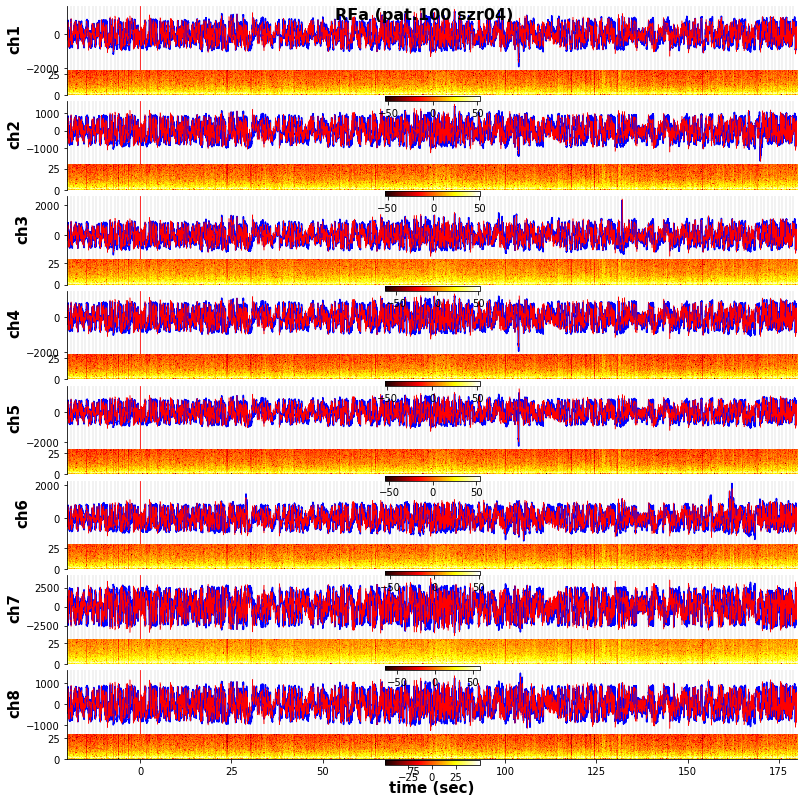

In [49]:
index = 8
roi = [regnames[index]]

plot_determine_onset_regions(path, so_sec=sosec, sf=sf, sec_before=20, sec_after=180, fmin=0, fmax=30, 
                                 plot_filt=True, region_list=roi, figlabel=None, save=False, savepath=None)

In [71]:
#modify SO_sec

delta_sec = +0
curr_index = new_df['SO_sec'][new_df['region']==roi[0]].index[0]
curr_val = new_df['SO_sec'][curr_index]
new_val = curr_val + delta_sec


modifyValueToDataframe(new_df, val=new_val, col='SO_sec', key=roi, key_col='region')
new_df

In [50]:
#remove region from seizureinvaded 
roi = [regnames[8]]
modifyValueToDataframe(new_df, val=0, col='seizureinvaded', key=roi, key_col='region')
new_df

,pnr,sznr,region,hemisphere,sf,SO_sec,SO_index,seizureinvaded
0,100,04,LA,L,1000,1800,1800000,1
1,100,04,LAH,L,1000,1800,1800000,1
2,100,04,LEC,L,1000,1800,1800000,1
3,100,04,LMH,L,1000,1800,1800000,1
4,100,04,LPHC,L,1000,1800,1800000,1
5,100,04,RA,R,1000,1800,1800000,1
6,100,04,RAH,R,1000,1800,1800000,1
7,100,04,REC,R,1000,1800,1800000,1
8,100,04,RFa,R,1000,1800,1800000,0
9,100,04,RFb,R,1000,1800,1800000,1


In [51]:
#save patient's dataset
outpath = '/media/Seizures/Wenzel/dataframes_patpool'
pnr, sznr = get_patinfo_from_path(path)
fname = f'patdata_{pnr}_{sznr}.pkl'
#chnamesDF.to_pickle(os.path.join(outpath, fname), mode='w', index=False)


new_df.to_pickle(os.path.join(outpath, fname))
#new_df.to_csv(os.path.join(outpath, fname.strip('.pkl')+'.csv'), mode='a+', header=False)

In [30]:
outpath='/media/Seizures/Wenzel/dataframes_patpool/'
fname = f'patdata_{pnr}_{sznr}.pkl'
#fname = 'sd_patientpool.pkl'
load_df = pd.read_pickle(os.path.join(outpath, fname))
load_df

,pnr,sznr,region,hemisphere,sf,SO_sec,SO_index,seizureinvaded,sd_invaded,SD_onset_sec,SD_duration_sec,ch_with_SD
0,092,03,LA,L,1000,1800,1800000,1,0,,,
1,092,03,LAH,L,1000,1800,1800000,1,1,1871,1878,"CSC9_reref_data.mat,CSC10_reref_data.mat,CSC13..."
2,092,03,LEC,L,1000,1800,1800000,1,0,,,
3,092,03,LMH,L,1000,1800,1800000,1,1,1871,1878,"CSC25_reref_data.mat,CSC26_reref_data.mat,CSC2..."
4,092,03,LPHC,L,1000,1800,1800000,0,,,,
5,092,03,LPIC,L,1000,1800,1800000,0,,,,
6,092,03,LTa,L,1000,1800,1800000,1,0,,,
7,092,03,LTb,L,1000,1800,1800000,1,0,,,


### read data


In [3]:
outpath='/media/Seizures/Wenzel/dataframes_patpool/'
files = glob.glob(os.path.join(outpath,'*.pkl'))

In [4]:
df = pd.concat([pd.read_pickle(fp) for fp in files], ignore_index=True)

In [5]:
df[df['seizureinvaded']==1]

,pnr,sznr,region,hemisphere,sf,SO_sec,SO_index,seizureinvaded,sd_invaded,SD_onset_sec,SD_duration_sec,ch_with_SD
0,089,03,LA,L,1000,1800,1800000,1,NaN,NaN,NaN,NaN
1,089,03,LAH,L,1000,1800,1800000,1,NaN,NaN,NaN,NaN
3,089,03,LMH,L,1000,1800,1800000,1,NaN,NaN,NaN,NaN
12,081,03,RAH,R,1000,1800,1800000,1,NaN,NaN,NaN,NaN
13,081,03,RTa,R,1000,1800,1800000,1,NaN,NaN,NaN,NaN
15,081,03,RTc,R,1000,1800,1800000,1,NaN,NaN,NaN,NaN
16,074,03,LA,L,1000,1800,1800000,1,NaN,NaN,NaN,NaN
17,074,03,LAH,L,1000,1800,1800000,1,NaN,NaN,NaN,NaN
18,074,03,LEC,L,1000,1800,1800000,1,NaN,NaN,NaN,NaN
19,074,03,LMH,L,1000,1800,1800000,1,NaN,NaN,NaN,NaN


In [208]:
patients = np.unique(load_df['pnr'])
seizures = np.unique(load_df['sznr'])
patients, seizures

(array(['092'], dtype=object), array(['03'], dtype=object))

In [210]:
(np.unique(new_df['pnr'])[0] in patients) and (np.unique(new_df['sznr'])[0] in seizures)

True

In [205]:
np.unique(new_df['pnr'])[0], np.unique(load_df['sznr'])[0]

'092'

# Test new channel-wise dataframe generation and modification

### 1) create a basic dataframe 

In [68]:
#Load data
path = '/media/Seizures/60min_cut/092/2021-09-21_08-52-50/'
#sf=1000
pnr, sznr = get_patinfo_from_path(path)
fname = f'patdata_{pnr}_{sznr}.pkl'
opath='/media/Seizures/Wenzel/dataframes_patpool/test'
if not os.path.isdir(opath):
    os.makedirs(opath)

#fname = f'patdata_{pnr}_{sznr}.pkl'
#load_df = pd.read_pickle(os.path.join(opath, dfname))
test_df =  make_basic_dataframe(path)
test_df

,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_sec,fname
0,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA1,LA,L,1000,1800,CSC1.ncs
1,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA2,LA,L,1000,1800,CSC2.ncs
2,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA3,LA,L,1000,1800,CSC3.ncs
3,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA4,LA,L,1000,1800,CSC4.ncs
4,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA5,LA,L,1000,1800,CSC5.ncs
...,...,...,...,...,...,...,...,...,...
59,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb4,LTb,L,1000,1800,CSC60.ncs
60,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb5,LTb,L,1000,1800,CSC61.ncs
61,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb6,LTb,L,1000,1800,CSC62.ncs
62,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb7,LTb,L,1000,1800,CSC63.ncs


### 2) save directory

In [6]:
test_df.to_pickle(os.path.join(opath, fname))

### 3) read dataframe of intrerest

In [56]:
load_df = pd.read_pickle(os.path.join(opath, fname))
load_df

,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_sec,fname
0,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA1,LA,L,1000,1800,CSC1.ncs
1,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA2,LA,L,1000,1800,CSC2.ncs
2,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA3,LA,L,1000,1800,CSC3.ncs
3,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA4,LA,L,1000,1800,CSC4.ncs
4,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA5,LA,L,1000,1800,CSC5.ncs
...,...,...,...,...,...,...,...,...,...
59,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb4,LTb,L,1000,1800,CSC60.ncs
60,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb5,LTb,L,1000,1800,CSC61.ncs
61,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb6,LTb,L,1000,1800,CSC62.ncs
62,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb7,LTb,L,1000,1800,CSC63.ncs


### 4) modify SO sec for all channels in region of interest (roi)

In [66]:
#modify SO_sec
regions = load_df['region'].unique().tolist()
index = 2
roi = regions[index]
delta_sec = 0
curr_idx = load_df['SO_sec'][load_df['region']==roi].index.tolist()
curr_val = load_df['SO_sec'][curr_idx].tolist()
new_val = [c + delta_sec for c in curr_val]
chnames_in_reg = load_df[load_df['region']==roi]['chname'].tolist()

#chnames_in_reg
modifyValueToDataframe(load_df, val=new_val[0], col='SO_sec', key=chnames_in_reg, key_col='chname')
load_df[load_df['region']==roi]

,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_sec,fname
16,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LEC1,LEC,L,1000,1800,CSC17.ncs
17,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LEC2,LEC,L,1000,1800,CSC18.ncs
18,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LEC3,LEC,L,1000,1800,CSC19.ncs
19,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LEC4,LEC,L,1000,1800,CSC20.ncs
20,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LEC5,LEC,L,1000,1800,CSC21.ncs
21,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LEC6,LEC,L,1000,1800,CSC22.ncs
22,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LEC7,LEC,L,1000,1800,CSC23.ncs
23,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LEC8,LEC,L,1000,1800,CSC24.ncs


### 5) save new dataframe and replace old one

In [60]:
load_df.to_pickle(os.path.join(opath, fname))

------

# use old format to pass new region-wise values to new format

In [9]:
#Load data
path = '/media/Seizures/60min_cut/100/2023-04-22_00-10-43/'
pnr, sznr = get_patinfo_from_path(path)
fname = f'patdata_{pnr}_{sznr}.pkl'
newpath='/media/Seizures/Wenzel/dataframes_patpool/test'
oldpath = '/media/Seizures/Wenzel/dataframes_patpool'

old_df = pd.read_pickle(os.path.join(oldpath, fname))
new_df = make_basic_dataframe(path)

In [10]:
old_df[old_df['region']=='LPHC']

,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_sec,fname,seizureinvaded,SO_index
32,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,LPHC1,LPHC,L,1000,1800,CSC33.ncs,1.0,1800000.0
33,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,LPHC2,LPHC,L,1000,1800,CSC34.ncs,1.0,1800000.0
34,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,LPHC3,LPHC,L,1000,1800,CSC35.ncs,1.0,1800000.0
35,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,LPHC4,LPHC,L,1000,1800,CSC36.ncs,1.0,1800000.0
36,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,LPHC5,LPHC,L,1000,1800,CSC37.ncs,1.0,1800000.0
37,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,LPHC6,LPHC,L,1000,1800,CSC38.ncs,1.0,1800000.0
38,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,LPHC7,LPHC,L,1000,1800,CSC39.ncs,1.0,1800000.0
39,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,LPHC8,LPHC,L,1000,1800,CSC40.ncs,1.0,1800000.0


In [11]:
#get the list of new keys and regions
new_keys = list(set(old_df.keys().tolist())-set(new_df.keys().tolist()))
regions = old_df['region'].unique().tolist()

In [12]:
#add the new values to old dictionary, paste for all electrodes per region
for reg in regions:
    print(f'working on {reg}')
    reg_indices = new_df[new_df['region']==reg].index.tolist()
    for k in new_keys:
        new_val = old_df.at[old_df.loc[old_df['region']==reg, k].index[0], k]
        
        for i in reg_indices:
            new_df.loc[i, k]=new_val

working on LA
working on LAH
working on LEC
working on LMH
working on LPHC
working on RA
working on RAH
working on REC
working on RFa
working on RFb
working on RFc
working on RMH
working on RPHC
working on RT


In [13]:
#change column name
if 'sd_invaded' in new_df.keys():
    new_df = new_df.rename(columns={'sd_invaded':'sdinvaded_region'})

#change column name
if 'SD_duration_sec' in new_df.keys():
    new_df = new_df.rename(columns={'SD_duration_sec':'SD_end_sec'})

In [14]:
#add if channels were SD invaded
if 'ch_with_SD' in new_df.keys():
    entries_with_sd = new_df[new_df['sdinvaded_region']==1].index.tolist()
    for sdreg in entries_with_sd:
        if  new_df.loc[sdreg, 'fname'].strip('.ncs') in new_df.loc[sdreg, 'ch_with_SD']:
            new_df.loc[sdreg, 'sdinvaded_ch'] =1
        else:
            new_df.loc[sdreg, 'sdinvaded_ch'] =0

In [15]:
#save dtaframe
new_df.to_pickle(os.path.join(oldpath, fname))

In [16]:
load_df = pd.read_pickle(os.path.join(oldpath, fname))
load_df

,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_sec,fname,seizureinvaded,SO_index
0,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,LA1,LA,L,1000,1800,CSC1.ncs,1.0,1800000.0
1,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,LA2,LA,L,1000,1800,CSC2.ncs,1.0,1800000.0
2,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,LA3,LA,L,1000,1800,CSC3.ncs,1.0,1800000.0
3,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,LA4,LA,L,1000,1800,CSC4.ncs,1.0,1800000.0
4,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,LA5,LA,L,1000,1800,CSC5.ncs,1.0,1800000.0
...,...,...,...,...,...,...,...,...,...,...,...
107,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,RT4,RT,R,1000,1800,CSC108.ncs,1.0,1800000.0
108,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,RT5,RT,R,1000,1800,CSC109.ncs,1.0,1800000.0
109,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,RT6,RT,R,1000,1800,CSC110.ncs,1.0,1800000.0
110,100,04,/media/Seizures/60min_cut/100/2023-04-22_00-10...,RT7,RT,R,1000,1800,CSC111.ncs,1.0,1800000.0


## Separate channels by region and plot around point of interest

In [4]:
path = '/media/Seizures/60min_cut/092/2021-09-21_08-52-50/'
#path = '/Volumes/ExtremeSSD/60min_cut/092/2021-09-21_08-52-50'
reref_path = find_dir(os.path.join(path, 'DS_data'), 'reref')
regions = get_region_name(path)
_ = get_matfile_chnames(reref_path)
chnames, matfiles = _[0], _[1]
sf = 1000

#get matfiles grouped by region
matfiles_dic = {key : [matfiles[i] for i, ch in enumerate(chnames) if ch in val] for key, val in regions.items()}

In [13]:
os.getcwd()

'/reref'

### initial plotting

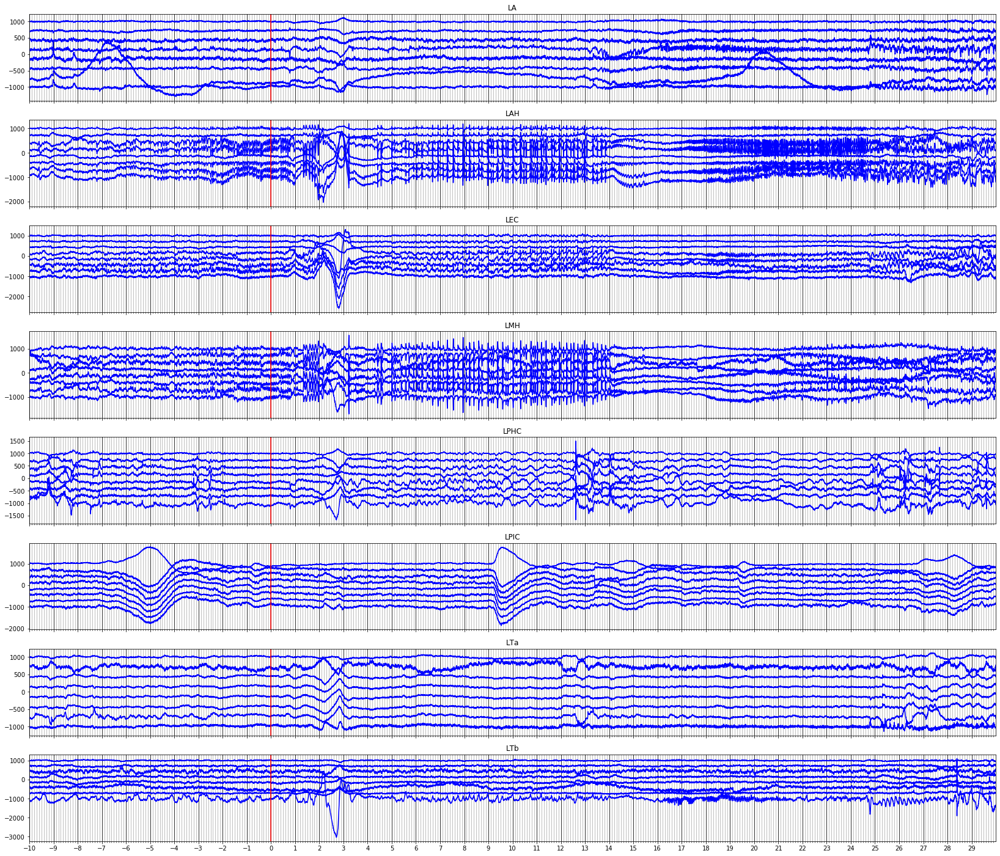

In [4]:
#PLOT PARAMS
my_dpi = 92
onset_sec = 30 * 60
sf = 1000
sec_before = 10
sec_after = 30

# PLOT VARIABLES
all_regions = list(matfiles_dic.keys())

fig, ax = plt.subplots(len(all_regions), figsize=(2100 / my_dpi, 1800 / my_dpi), sharex=True)

for ix, reg in enumerate(all_regions):
    curr_reg = matfiles_dic[reg]
    offsets = np.linspace(-1000, 1000, len(curr_reg))
    for i, ch in enumerate(curr_reg):
        file = readMatfile(os.path.join(reref_path, ch))
        data = file.reref_data[(onset_sec * sf) - (sec_before * sf):(onset_sec * sf) + (sec_after * sf)]
        offset = offsets[i]
        ax[ix].plot(np.linspace(-sec_before, sec_after, len(data)), data+offset, c="b")

    ax[ix].set_title(reg)
    ax[ix].axvline(x=0, color='red')

    # set xaxis params
    ax[ix].set_xlim(-sec_before, sec_after)
    ax[ix].set_xticks(np.arange(-sec_before, sec_after, 1), minor=False)
    ax[ix].set_xticks(np.arange(-sec_before, sec_after, 0.1), minor=True)

    # Apply grid settings to individual axes
    ax[ix].grid(visible=True, which='minor', axis='x')
    ax[ix].grid(visible=True, which='major', axis='x', linewidth=0.8, color='k')

fig.tight_layout()
plt.show()

### plot macros in the same fashion

In [4]:
path = '/media/Seizures/60min_cut/092/2021-09-21_08-52-50/'
#path = '/Volumes/ExtremeSSD/60min_cut/092/2021-09-21_08-52-50'

macro_path = find_dir(path, 'macro')
macro_DS_path = find_dir(macro_path, 'DS_data')

if macro_DS_path:
    macro_reref = find_dir(macro_DS_path, 'reref')
else:
    macro_reref = macro_DS_path
    
#get region names
regions = get_region_name(macro_path)
#macro_regions = dict(keys=from_micro_to_macro_names(regions.keys()))

#get files
_ = get_matfile_chnames(macro_reref)
chnames, matfiles = _[0], _[1]
chnames_reref = [c for c in chnames if '8' not in c]
sf = 2000

#get matfiles grouped by region
macro_matfiles_dic = {key : [matfiles[i] for i, ch in enumerate(chnames_reref) if ch in val] for key, val in regions.items()}

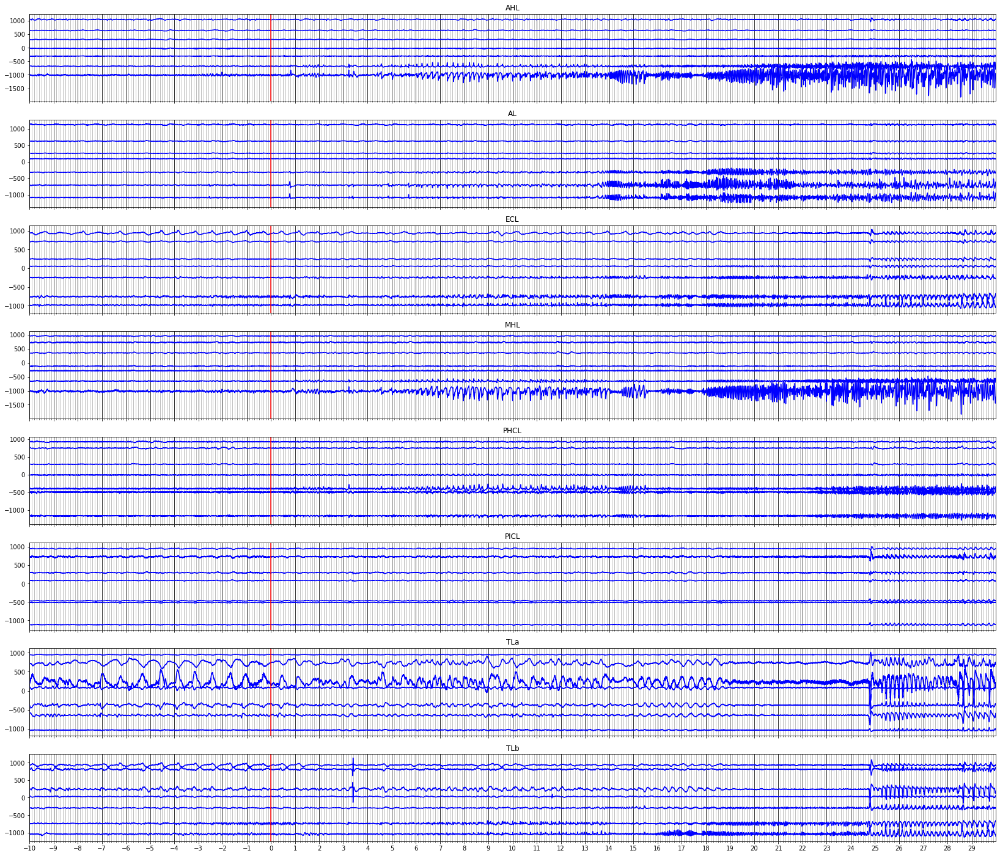

In [5]:
#PLOT PARAMS
my_dpi = 92
onset_sec = 30 * 60
sf = 2000
sec_before = 10
sec_after = 30

# PLOT VARIABLES
all_regions = list(macro_matfiles_dic.keys())

fig, ax = plt.subplots(len(all_regions), figsize=(2100 / my_dpi, 1800 / my_dpi), sharex=True)

for ix, reg in enumerate(all_regions):
    curr_reg = macro_matfiles_dic[reg]
    offsets = np.linspace(-1000, 1000, len(curr_reg))
    for i, ch in enumerate(curr_reg):
        #print(ch)
        file = readMatfile(os.path.join(macro_reref, ch))
        data = file.reref_data[(onset_sec * sf) - (sec_before * sf):(onset_sec * sf) + (sec_after * sf)]
        offset = offsets[i]
        ax[ix].plot(np.linspace(-sec_before, sec_after, len(data)), data+offset, c="b")

    ax[ix].set_title(reg)
    ax[ix].axvline(x=0, color='red')

    # set xaxis params
    ax[ix].set_xlim(-sec_before, sec_after)
    ax[ix].set_xticks(np.arange(-sec_before, sec_after, 1), minor=False)
    ax[ix].set_xticks(np.arange(-sec_before, sec_after, 0.1), minor=True)

    # Apply grid settings to individual axes
    ax[ix].grid(visible=True, which='minor', axis='x')
    ax[ix].grid(visible=True, which='major', axis='x', linewidth=0.8, color='k')

fig.tight_layout()
plt.show()

### Plot each region, channel by channel with spectrogram

### micros

In [2]:
def plotObject(nrChannels, myDpi=92, lenXax=1900, lenYax=1024, shareX=False, shareY=False):
    '''
    '''
    import matplotlib.pyplot as plt
    from matplotlib import gridspec
    
    fig, axs = plt.subplots(nrChannels*2, 1, figsize=(lenXax/myDpi, lenYax/myDpi), sharex=shareX, sharey=shareY)
    gs = gridspec.GridSpec(nrChannels*2, 1, height_ratios=[1, 0.5]*(nrChannels))
    spines = ('top', 'right', 'bottom')
    for i in range(nrChannels*2):
        axs[i] = plt.subplot(gs[i])
        for sp in spines: 
            axs[i].spines[sp].set_visible(False)
        axs[i].tick_params(bottom=False, labelbottom=False)
    axs[i].spines[sp].set_visible(True)
    axs[i].tick_params(bottom=True, labelbottom=True)
    #remove spines
   
    fig.tight_layout()
    fig.subplots_adjust(hspace=.0)
    #fig.tight_layout()
    #plt.show()
    return fig, axs

In [3]:
def adjustPathToLatestPreprocessingStep(path, start='DS_data', stop='reref'):
    '''adjusts path to the latest 
    stage of preprocessing
    
    Params:
    path, str or path object: path to session data
    stop, str: where in the path to stop looking
    
    Returns:
    path, os.path(): path to latest preprocessing stage
    '''
    
    a = start
    o = stop
    
    if path.endswith('/'):
        path = os.path.dirname(path) #fix path parsing issue
        
    #look for paths
    path_ = find_dir(path, a)
    
    if path_:
        path = path_
        del path_
    
    path_ = find_dir(path, o)
    
    if path_:
        path = path_
        del path_
    
    return path

In [4]:
from scipy.signal import butter, lfilter

def butter_bandpass(lowcut, highcut, fs, order=5):
    return butter(order, [lowcut, highcut], fs=fs, btype='band')

def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

In [5]:
def make_basic_dataframe(path, sf=1000, so_sec=30*60):
    rerefpath = find_dir(path, 'reref')
    fnames = match_cssfiles_to_chnames(path)
    pnr, sznr = get_patinfo_from_path(path)
    chnames = get_chnames(path, strip=True)
    matfiles_data = [x.strip('.ncs')+'_reref_data.mat' for x in fnames]
    matfiles_times = [x.strip('.ncs')+'_reref_times.mat' for x in fnames]
    
    #calculate reported seizure onset timestamp
    
    #sf = 1000
    times = loadmat(os.path.join(rerefpath,matfiles_times[0]))
    tstamps = times['reref_times'][0]
    so_index = int(so_sec*sf)
    reported_so_ts = tstamps[int(so_sec*sf)]

    df = pd.DataFrame()
    
    #add all other important data
    for i, ch in enumerate(chnames):
        df['pnr'] = pnr
        df['sznr'] = sznr
        df['datapath'] = rerefpath
        df['chname'] = chnames
        df['region'] = [x[:-1] for x in chnames]
        df['hemisphere'] = [x[0] for x in chnames]
        df['sf'] = sf
        df['SO_ts'] = reported_so_ts
        df['SO_sec'] = so_sec
        df['SO_index'] = so_index
    return df

In [14]:
def modifyValueToDataframe(df, val, col, key=None, key_col=None):
    '''modifies value to pandas dataframe
    if key=None, it adds value to all entries, else 
    it does it only to filtered (through key) dataframe'''
    
    if not col in df.keys().tolist():
        df[col] = ''*len(df)
    
    if type(key)==list:
        for k in key:
            df.loc[df[key_col]==k, [col]] = val
    else:
        df[col] = val

In [7]:
def plot_determine_onset_regions(path, so_sec=30*60, sf=1000, sec_before=60, sec_after=120, fmin=0, fmax=30, 
                                 plot_filt=False, region_list=None, figlabel=None, save=False, savepath=None):
    
    
    reref_path = adjustPathToLatestPreprocessingStep(path)
    _regions = get_region_name(path)
    
    if region_list:
        regions = {k:v for k,v in _regions.items() if k in region_list}
    else:
        regions = _regions
    del _regions
    
    _ = get_matfile_chnames(reref_path)
    chnames, matfiles = _[0], _[1]
    
    if not savepath:
        savepath = path
    
    #get matfiles grouped by region
    #if not region_list:
    matfiles_dic = {key : [matfiles[i] for i, ch in enumerate(chnames) if ch in val] 
                        for key, val in regions.items()}
    
    #PLOT PARAMS
    my_dpi = 92
    
    # PLOT VARIABLES
    all_regions = list(matfiles_dic.keys())
    pnr, sznr = get_patinfo_from_path(path)
    
    
    
    for ix, reg in enumerate(all_regions):
        curr_reg = matfiles_dic[reg]
        fig, ax = plotObject(nrChannels=len(curr_reg), lenXax=1000, lenYax=1024, shareY=True)
        offsets = np.linspace(-1000, 1000, len(curr_reg))
        #print(reg)
        for i, ch in enumerate(curr_reg):

            #Fill dataframe info
            #dataDf['pnr'] = 
            file = readMatfile(os.path.join(reref_path, ch))
            data = file.reref_data[(so_sec * sf) - (sec_before * sf):(so_sec * sf) + (sec_after * sf)]

            timeax = np.linspace(-sec_before, sec_after, len(data))
            offset = offsets[i]
            f_axis, t_axis, spg = spectrogram(data, fs=sf, nperseg=200, noverlap=150, scaling='density')


            if plot_filt:
                ax[i*2].plot(timeax, data, c="b")
                filt = butter_bandpass_filter(data, lowfreq, fmax, fs=sf, order=1)
                ax[i*2].plot(timeax, filt, c="red", linewidth=0.5)
            else:
                ax[i*2].plot(timeax, data, c="b", linewidth=0.5)

            ax[i*2].set_ylabel(f'ch{i+1}', fontweight='bold', fontsize=15)
            spec = ax[(i*2)+1].imshow(10*np.log10(spg[fmin:fmax,]), aspect='auto', cmap='hot', origin='lower',
                                     extent=[min(timeax), max(timeax), fmin, fmax])#, vmin=-3, vmax=3)

            fig.colorbar(spec, ax=ax[(i*2)+1], orientation='horizontal', pad=0.05)

            ax[i*2].set_xlim(-sec_before, sec_after)
            ax[i*2].set_xticks(np.arange(-sec_before, sec_after, 1), minor=False)
            #ax[i*2].set_xticks(np.arange(-sec_before, sec_after, 0.1), minor=True)

            # Apply grid settings to individual axes
            #ax[i*2].grid(visible=True, which='minor', axis='x')
            ax[i*2].grid(visible=True, which='major', axis='x', linewidth=0.1, color='k')
            ax[i*2].axvline(0, color='red', linewidth=0.8)
            fig.suptitle(f'{reg} (pat.{pnr} szr{sznr})',fontweight="bold", fontsize=16)

        ax[i*2+1].tick_params(bottom=True, labelbottom=True)
        ax[i*2+1].set_xlabel('time (sec)', fontweight='bold', fontsize=15)

        if save:
            spath = os.path.join(savepath, 'plots_so_determination')

            if not os.path.exists(spath):
                print(f'creating path for saving: {spath}')
                os.mkdir(spath)

            figname= f'{reg}_so_determiation'
            
            if figlabel:
                figname += figlabel
            
            plt.savefig(os.path.join(spath, figname+'.png'))
            print(f'saving plot {figname} in {spath}')
        #figname = label+''
        plt.show()

# Create plots for patients of interest

#### p.92, s.03

In [2]:
path = '/media/Seizures/60min_cut/092/2021-09-21_08-52-50/'
sosec = 30*60
sf=1000
outpath = path

#make datatframe for patient
dataDf = make_basic_dataframe(path, sf=sf, so_sec=sosec)
#modifyValueToDataframe(dataDf, val=1, col='seizureinvaded')

#save datatframe
#pnr, sznr = get_patinfo_from_path(path)
#dataframe_name = f'so_info_{pnr}_{sznr}'
#dataDf.to_pickle(os.path.join(outpath, dataframe_name+'.pkl'))
#dataDf.to_csv(os.path.join(outpath, dataframe_name+'.csv'))

#plot all plots
#plot_determine_onset_regions(path, so_sec=sosec, sf=sf, sec_before=60, sec_after=120, fmin=0, fmax=30, 
#                                 plot_filt=False, region_list=None, figlabel=None, save=True, savepath=None)

In [4]:
dataDf

,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_ts,SO_sec,SO_index
0,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA1,LA,L,1000,1.632216e+15,1800,1800000
1,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA2,LA,L,1000,1.632216e+15,1800,1800000
2,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA3,LA,L,1000,1.632216e+15,1800,1800000
3,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA4,LA,L,1000,1.632216e+15,1800,1800000
4,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA5,LA,L,1000,1.632216e+15,1800,1800000
...,...,...,...,...,...,...,...,...,...,...
59,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb4,LTb,L,1000,1.632216e+15,1800,1800000
60,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb5,LTb,L,1000,1.632216e+15,1800,1800000
61,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb6,LTb,L,1000,1.632216e+15,1800,1800000
62,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb7,LTb,L,1000,1.632216e+15,1800,1800000


In [155]:
modifyValueToDataframe(dataDf, val=0, col='seizureinvaded')
modifyValueToDataframe(dataDf, val=1, col='seizureinvaded', key=['LA'], key_col='region')

In [156]:
dataDf

,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_ts,SO_sec,SO_index,seizureinvaded
0,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA1,LA,L,1000,1.632216e+15,1800,1800000,1
1,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA2,LA,L,1000,1.632216e+15,1800,1800000,1
2,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA3,LA,L,1000,1.632216e+15,1800,1800000,1
3,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA4,LA,L,1000,1.632216e+15,1800,1800000,1
4,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA5,LA,L,1000,1.632216e+15,1800,1800000,1
...,...,...,...,...,...,...,...,...,...,...,...
59,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb4,LTb,L,1000,1.632216e+15,1800,1800000,0
60,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb5,LTb,L,1000,1.632216e+15,1800,1800000,0
61,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb6,LTb,L,1000,1.632216e+15,1800,1800000,0
62,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb7,LTb,L,1000,1.632216e+15,1800,1800000,0


In [25]:
la_df = df[df['region']=='LA']
la_df['sf'] = 500


/tmp/ipykernel_1000201/2663796609.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  la_df['sf'] = 500


In [11]:


dataDf['chname'] = [x.strip('.ncs') for x in chnames]

In [44]:
index_col = df.columns.get_loc('region')
index_row = df.index[df['region']==['LA','LAH']].to_list()
df.loc[index_row, 'region'] = 'la'

ValueError: ('Lengths must match to compare', (64,), (2,))

In [43]:
df

,pnr,sznr,datapath,chname,region,hemisphere,sf,SO_ts,SO_sec
0,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA1,la,L,1000,1.632216e+15,1800
1,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA2,la,L,1000,1.632216e+15,1800
2,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA3,la,L,1000,1.632216e+15,1800
3,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA4,la,L,1000,1.632216e+15,1800
4,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LA5,la,L,1000,1.632216e+15,1800
...,...,...,...,...,...,...,...,...,...
59,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb4,LTb,L,1000,1.632216e+15,1800
60,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb5,LTb,L,1000,1.632216e+15,1800
61,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb6,LTb,L,1000,1.632216e+15,1800
62,092,03,/media/Seizures/60min_cut/092/2021-09-21_08-52...,LTb7,LTb,L,1000,1.632216e+15,1800


In [181]:
path = '/media/Seizures/60min_cut/092/2021-09-21_08-52-50/'
#path = '/Volumes/ExtremeSSD/60min_cut/092/2021-09-21_08-52-50'
#macro_path = find_dir(path, 'macro')
#reref_path = find_dir(os.path.join(path, 'DS_data'), 'reref')
reref_path = adjustPathToLatestPreprocessingStep(path)
regions = get_region_name(path)
_ = get_matfile_chnames(reref_path)
chnames, matfiles = _[0], _[1]
sf = 1000

#get matfiles grouped by region
matfiles_dic = {key : [matfiles[i] for i, ch in enumerate(chnames) if ch in val] for key, val in regions.items()}

#Start dataframe to store data at
dfKeys = ['pnr', 'sznr', 'datapath', 'reg', 'chname', 'SO_sec', 'SO_ts', 'seizureInvadedReg', 'SeizureIndavdedCh']
#dataDict = dict()
dataDf = pd.DataFrame(columns=dfKeys)


saving plot LA_so_determiation in /media/Seizures/60min_cut/092/2021-09-21_08-52-50/plots_so_determination


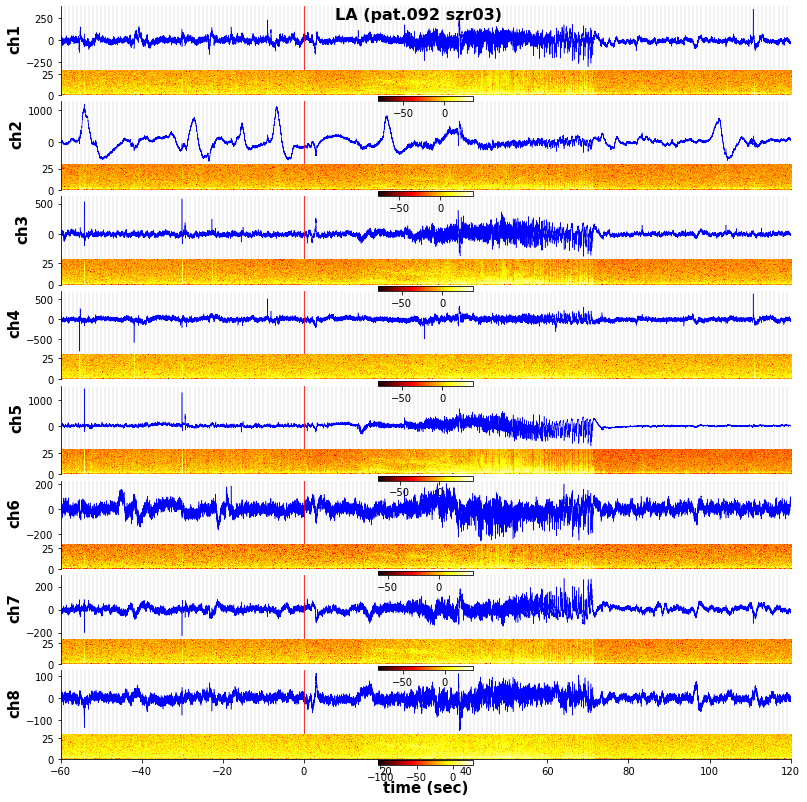

saving plot LAH_so_determiation in /media/Seizures/60min_cut/092/2021-09-21_08-52-50/plots_so_determination


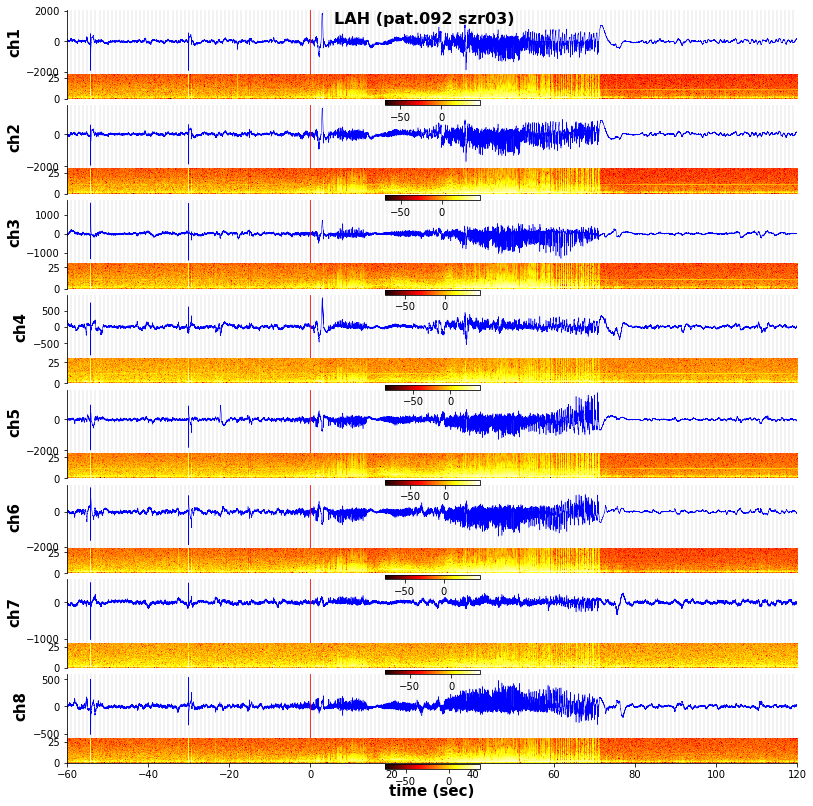

saving plot LEC_so_determiation in /media/Seizures/60min_cut/092/2021-09-21_08-52-50/plots_so_determination


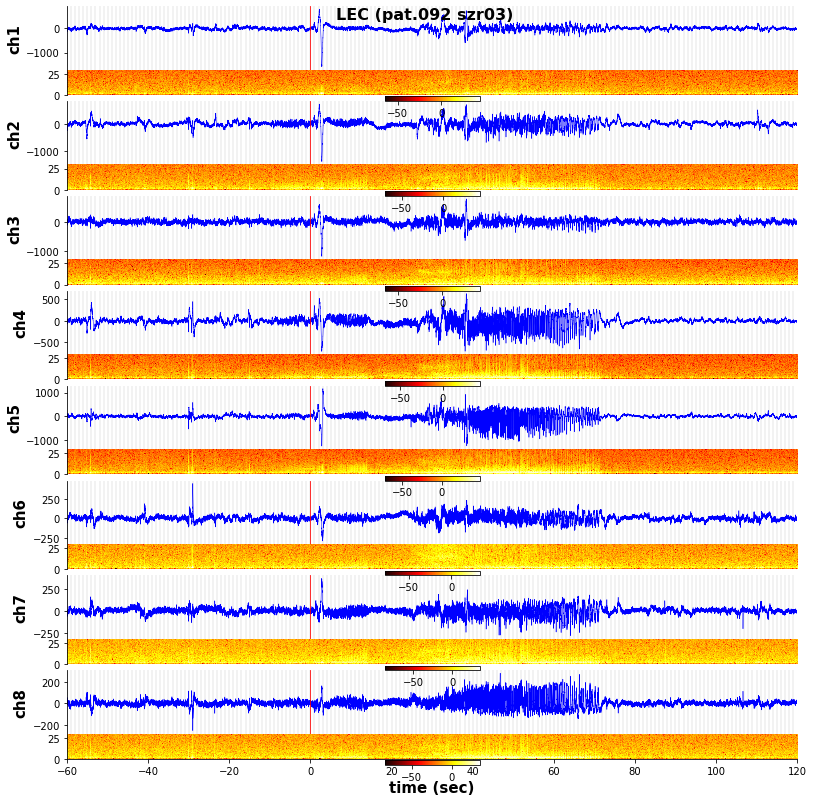

saving plot LMH_so_determiation in /media/Seizures/60min_cut/092/2021-09-21_08-52-50/plots_so_determination


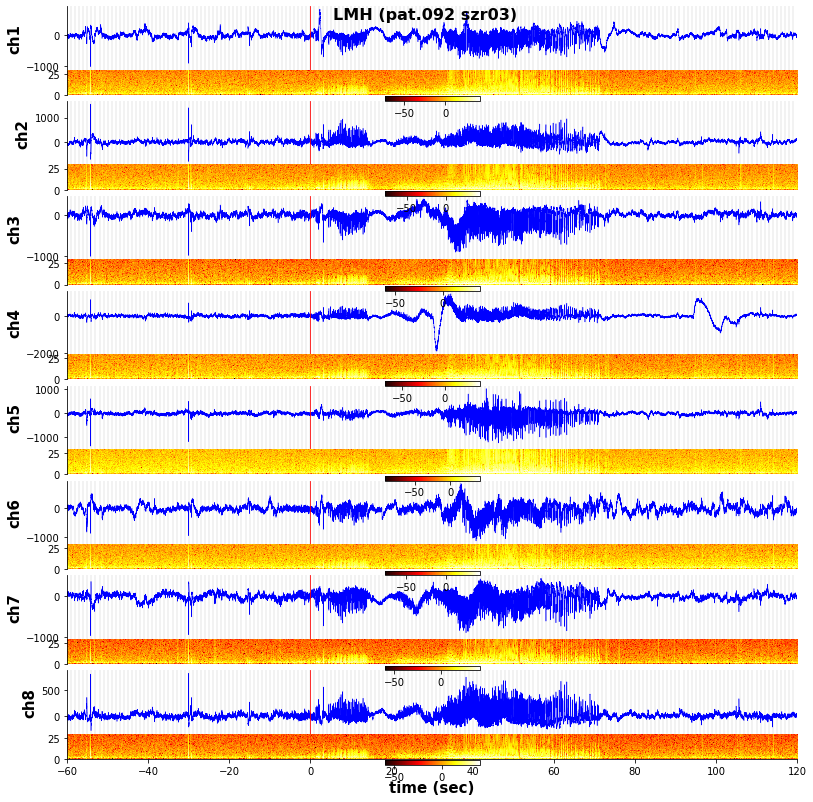

saving plot LPHC_so_determiation in /media/Seizures/60min_cut/092/2021-09-21_08-52-50/plots_so_determination


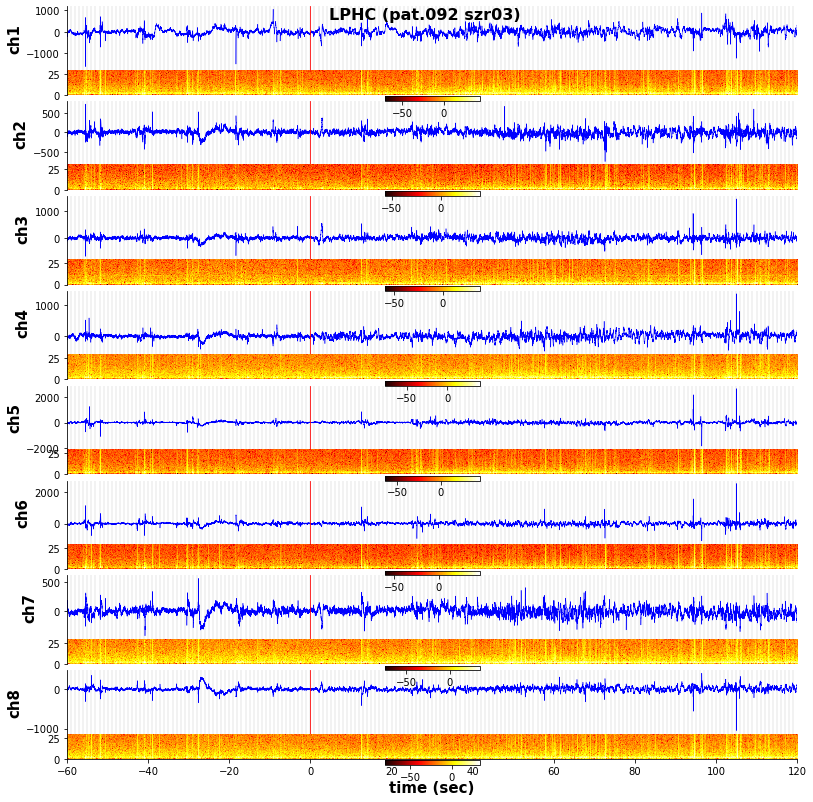

saving plot LPIC_so_determiation in /media/Seizures/60min_cut/092/2021-09-21_08-52-50/plots_so_determination


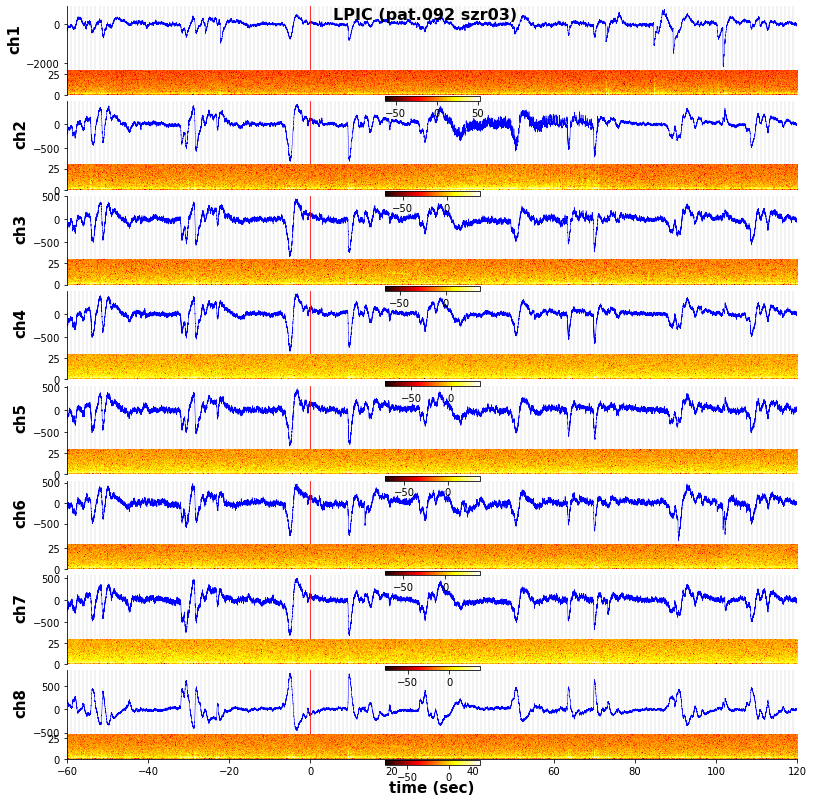

saving plot LTa_so_determiation in /media/Seizures/60min_cut/092/2021-09-21_08-52-50/plots_so_determination


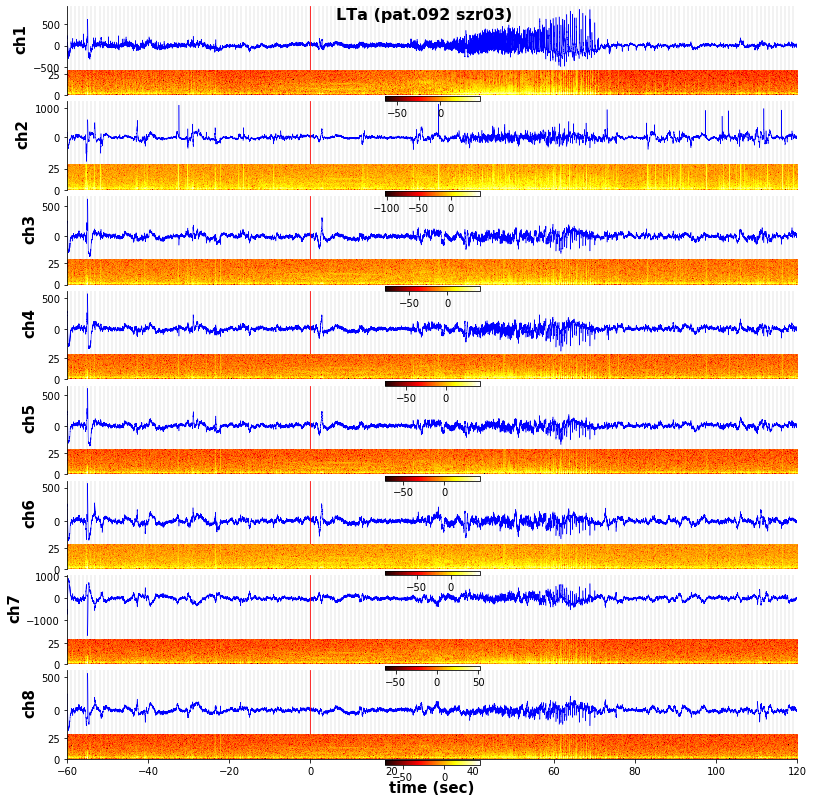

saving plot LTb_so_determiation in /media/Seizures/60min_cut/092/2021-09-21_08-52-50/plots_so_determination


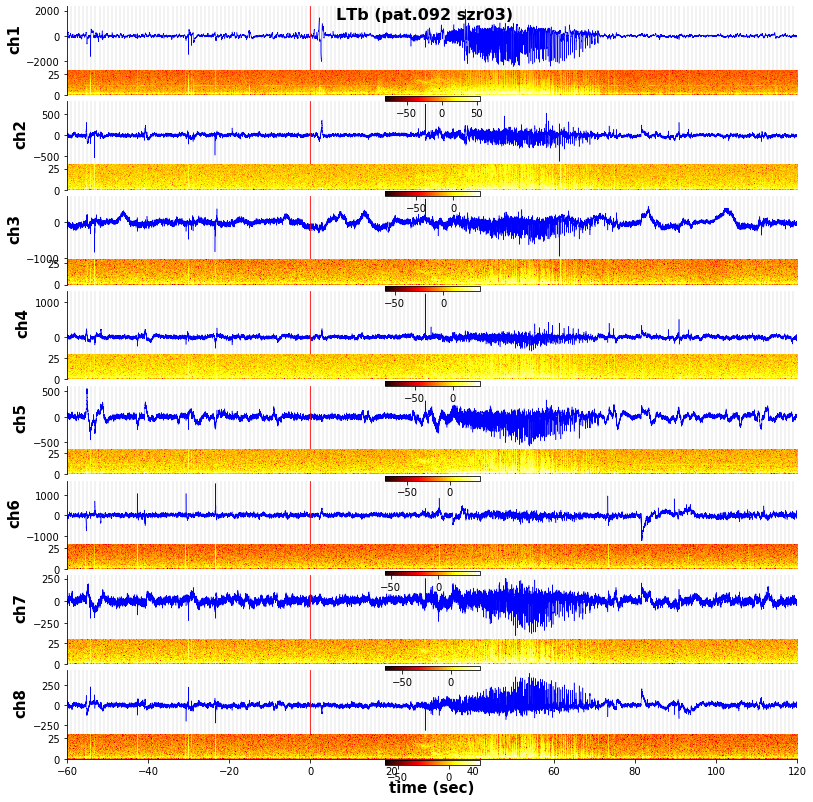

In [213]:
plot_determine_onset_regions(path, so_sec=(30*60), sf=1000, sec_before=60, sec_after=120, fmin=0, fmax=30, 
                                 plot_filt=False, region_list=None, figlabel=None, save=True, savepath=None)

In [196]:
regions_list = ['LA']
regions2 = {k:v for k,v in regions.items() if k in regions_list}

matfiles_dic2 = {key : [matfiles[i] for i, ch in enumerate(chnames) if ch in val] 
                        for key, val in regions2.items()}




In [197]:
matfiles_dic2

{'LA': ['CSC1_reref_data.mat',
  'CSC2_reref_data.mat',
  'CSC3_reref_data.mat',
  'CSC4_reref_data.mat',
  'CSC5_reref_data.mat',
  'CSC6_reref_data.mat',
  'CSC7_reref_data.mat',
  'CSC8_reref_data.mat']}

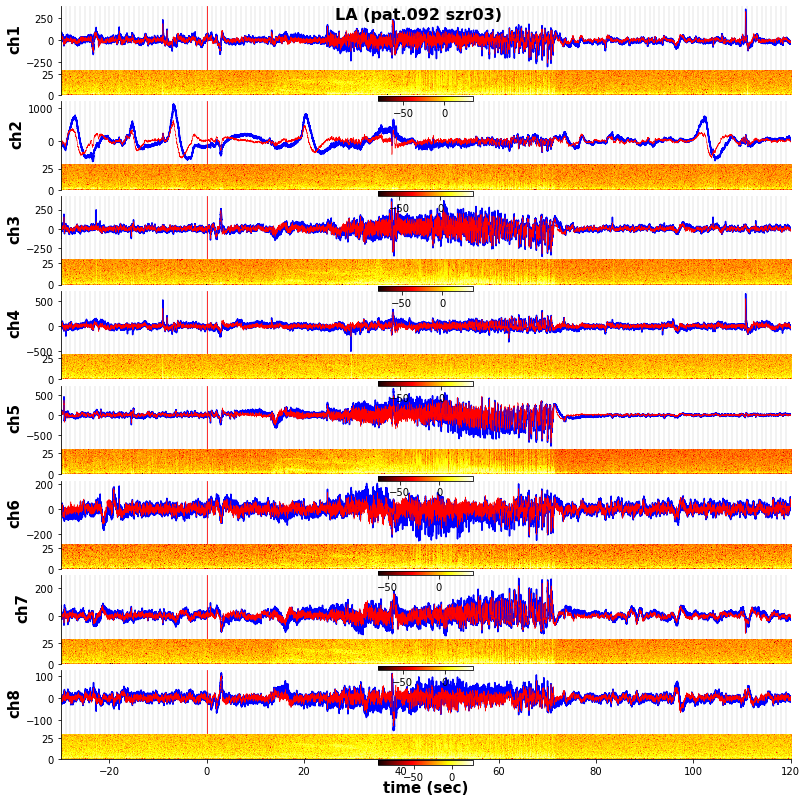

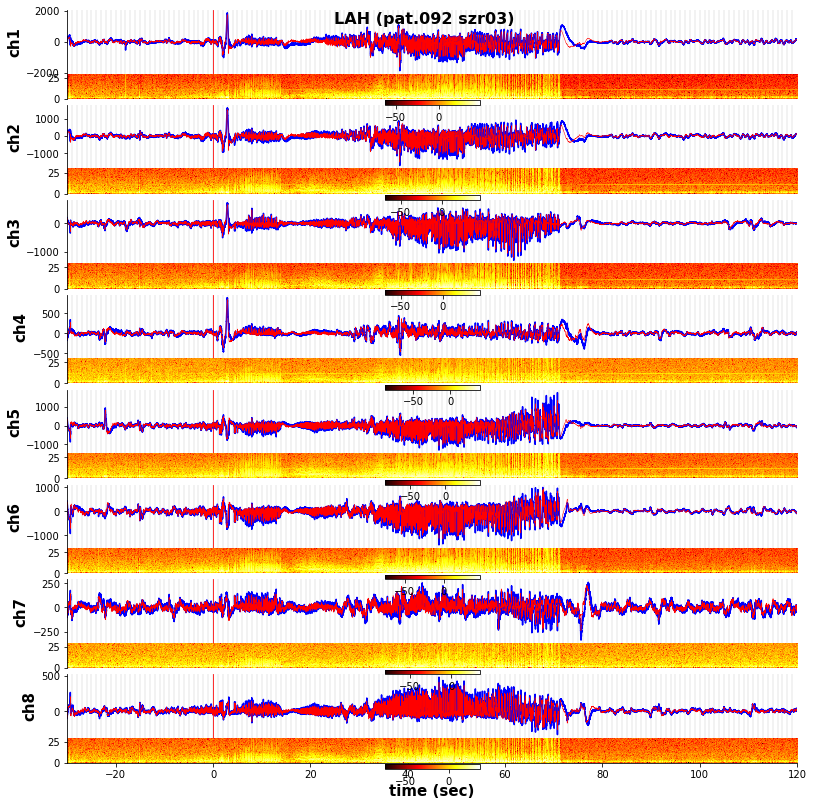

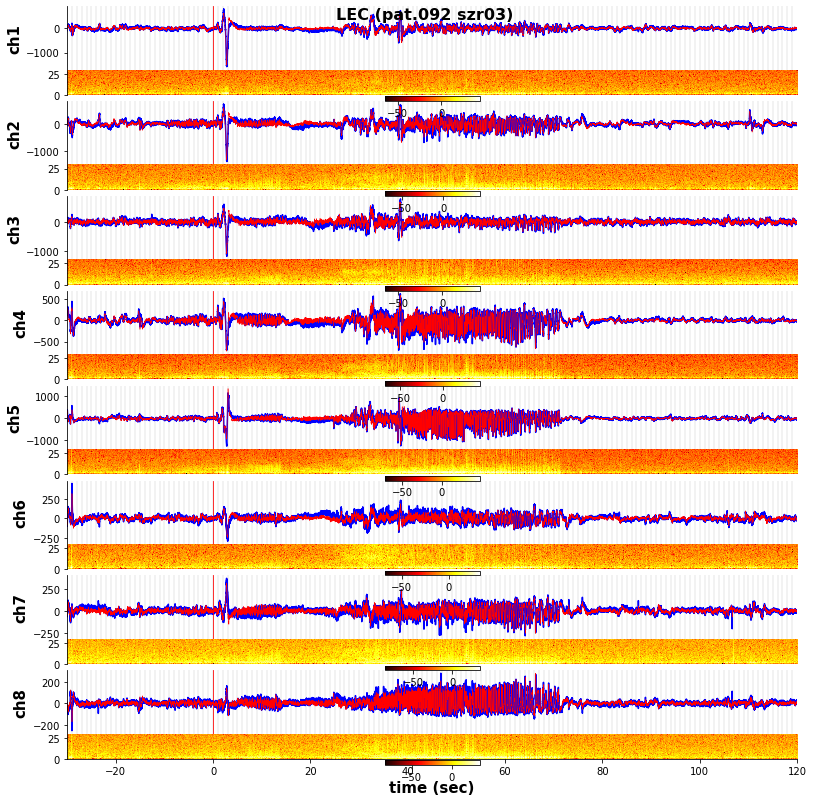

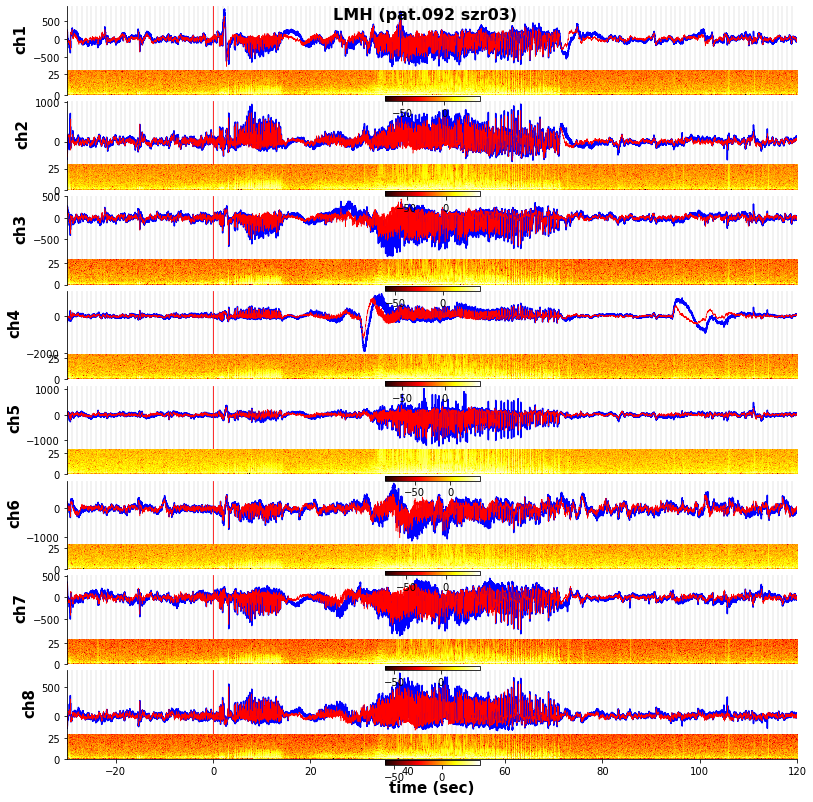

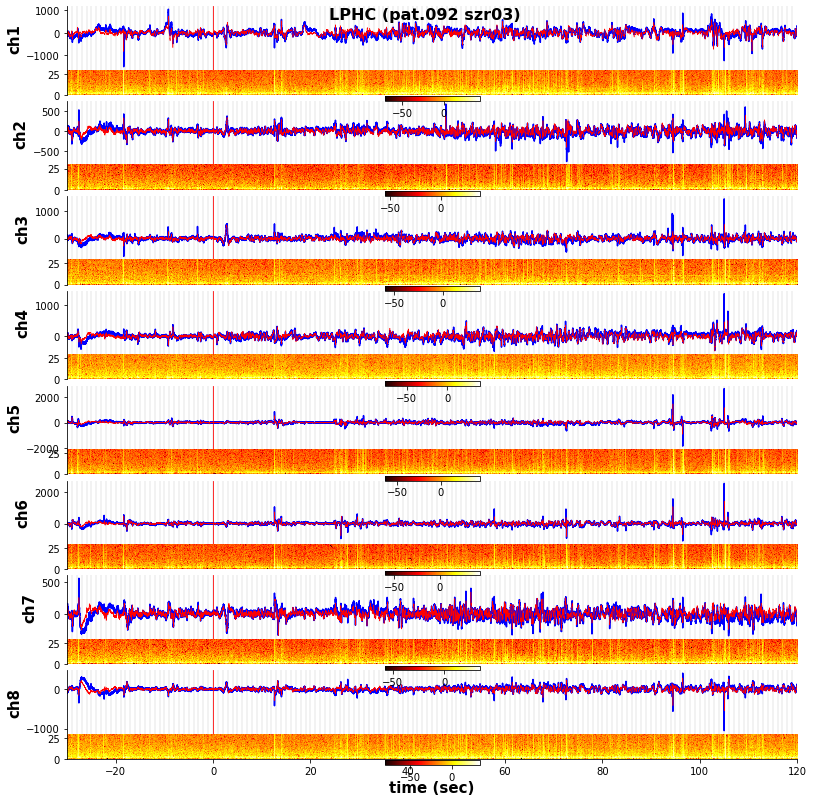

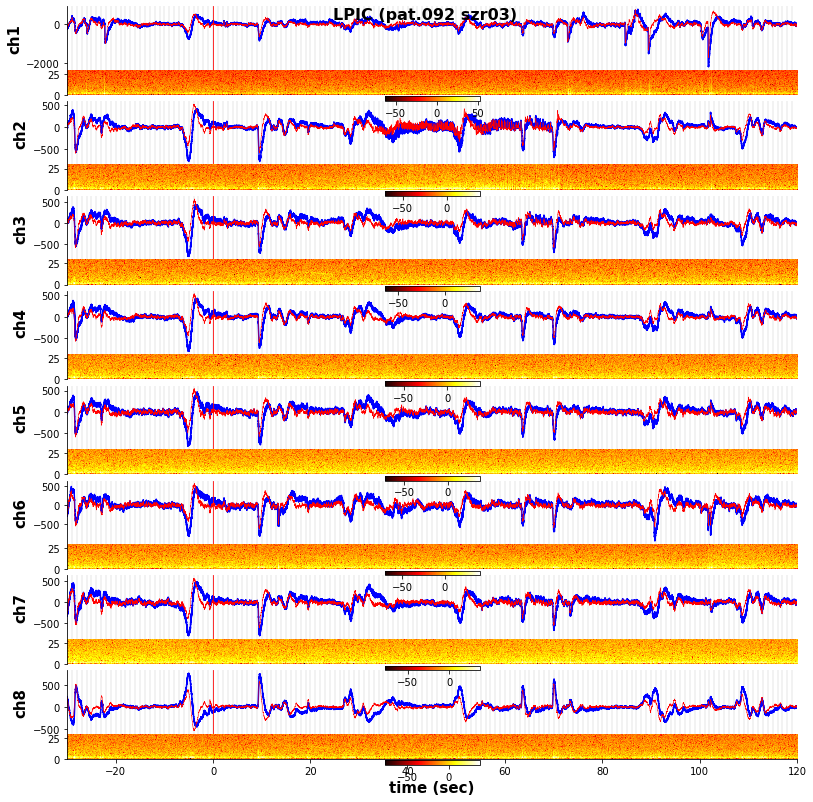

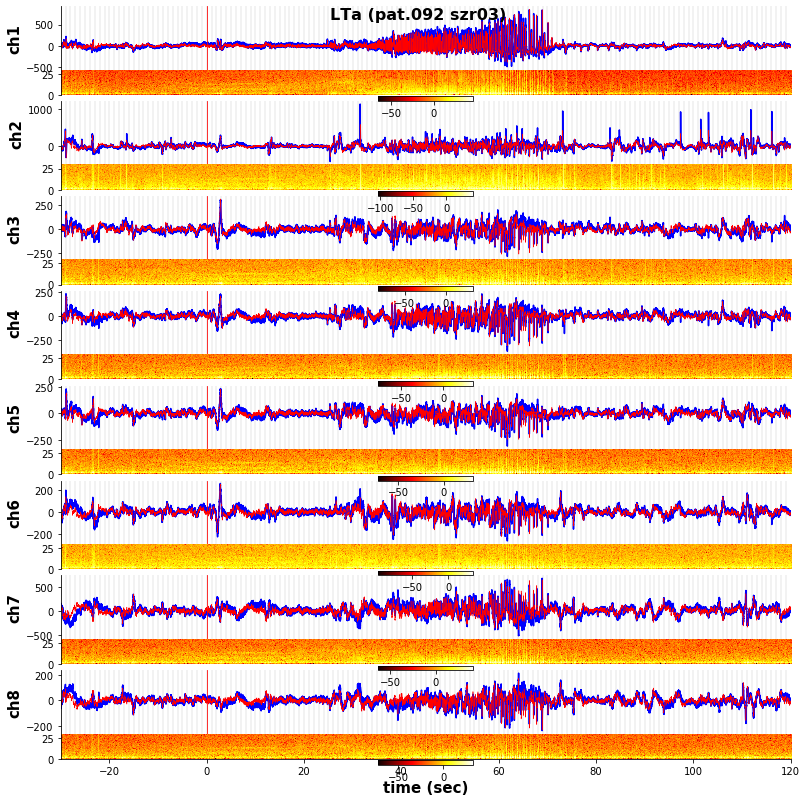

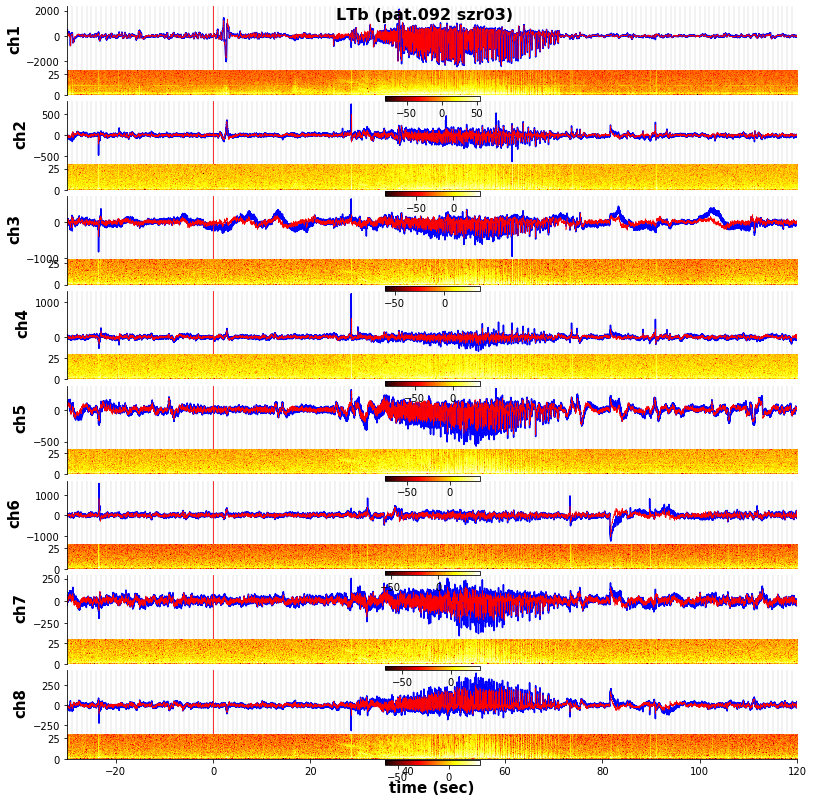

In [20]:
#PLOT PARAMS
my_dpi = 92
onset_sec = (30 * 60) + 0
sf = 1000
sec_before = 30
sec_after = 120
fmin = 0
fmax = 30

plotFilt = True

label = 'micro_so'
out_dirname = os.path.join(path, )

if plotFilt:
    if fmin ==0:
        lowfreq = 0.2
    else:
        lowfreq = fmin
# PLOT VARIABLES
all_regions = list(matfiles_dic.keys())
pnr, sznr = get_patinfo_from_path(path)

for ix, reg in enumerate(all_regions):
    curr_reg = matfiles_dic[reg]
    fig, ax = plotObject(nrChannels=len(curr_reg), lenXax=1000, lenYax=1024, shareY=True)
    offsets = np.linspace(-1000, 1000, len(curr_reg))
    #print(reg)
    for i, ch in enumerate(curr_reg):
        
        #Fill dataframe info
        #dataDf['pnr'] = 
        file = readMatfile(os.path.join(reref_path, ch))
        data = file.reref_data[(onset_sec * sf) - (sec_before * sf):(onset_sec * sf) + (sec_after * sf)]
        
        timeax = np.linspace(-sec_before, sec_after, len(data))
        offset = offsets[i]
        f_axis, t_axis, spg = spectrogram(data, fs=sf, nperseg=200, noverlap=150, scaling='density')
        
        ax[i*2].plot(timeax, data, c="b")
        
        if plotFilt:
            filt = butter_bandpass_filter(data, lowfreq, fmax, fs=sf, order=1)
            ax[i*2].plot(timeax, filt, c="red", linewidth=0.5)
        
        ax[i*2].set_ylabel(f'ch{i+1}', fontweight='bold', fontsize=15)
        spec = ax[(i*2)+1].imshow(10*np.log10(spg[fmin:fmax,]), aspect='auto', cmap='hot', origin='lower',
                                 extent=[min(timeax), max(timeax), fmin, fmax])#, vmin=-3, vmax=3)
        
        fig.colorbar(spec, ax=ax[(i*2)+1], orientation='horizontal', pad=0.05)
        
        ax[i*2].set_xlim(-sec_before, sec_after)
        ax[i*2].set_xticks(np.arange(-sec_before, sec_after, 1), minor=False)
        #ax[i*2].set_xticks(np.arange(-sec_before, sec_after, 0.1), minor=True)

        # Apply grid settings to individual axes
        #ax[i*2].grid(visible=True, which='minor', axis='x')
        ax[i*2].grid(visible=True, which='major', axis='x', linewidth=0.1, color='k')
        ax[i*2].axvline(0, color='red', linewidth=0.8)
        fig.suptitle(f'{reg} (pat.{pnr} szr{sznr})',fontweight="bold", fontsize=16)
        
    ax[i*2+1].tick_params(bottom=True, labelbottom=True)
    ax[i*2+1].set_xlabel('time (sec)', fontweight='bold', fontsize=15)

figname = label+''
plt.show()

### macros

In [52]:
path = '/media/Seizures/60min_cut/092/2021-09-21_08-52-50/'
#path = '/Volumes/ExtremeSSD/60min_cut/092/2021-09-21_08-52-50'
macro_path = find_dir(path, 'macro')
path_macro = adjustPathToLatestPreprocessingStep(macro_path)


#path = '/Volumes/ExtremeSSD/60min_cut/092/2021-09-21_08-52-50'
#reref_path = find_dir(os.path.join(path, 'DS_data'), 'reref')
regions = get_region_name(macro_path)
_ = get_matfile_chnames(path_macro)
chnames, matfiles = _[0], _[1]
chnames_reref = [c for c in chnames if '8' not in c]
chnames = chnames_reref
sf = 2000

#get matfiles grouped by region
matfiles_dic = {key : [matfiles[i] for i, ch in enumerate(chnames_reref) if ch in val] for key, val in regions.items()}

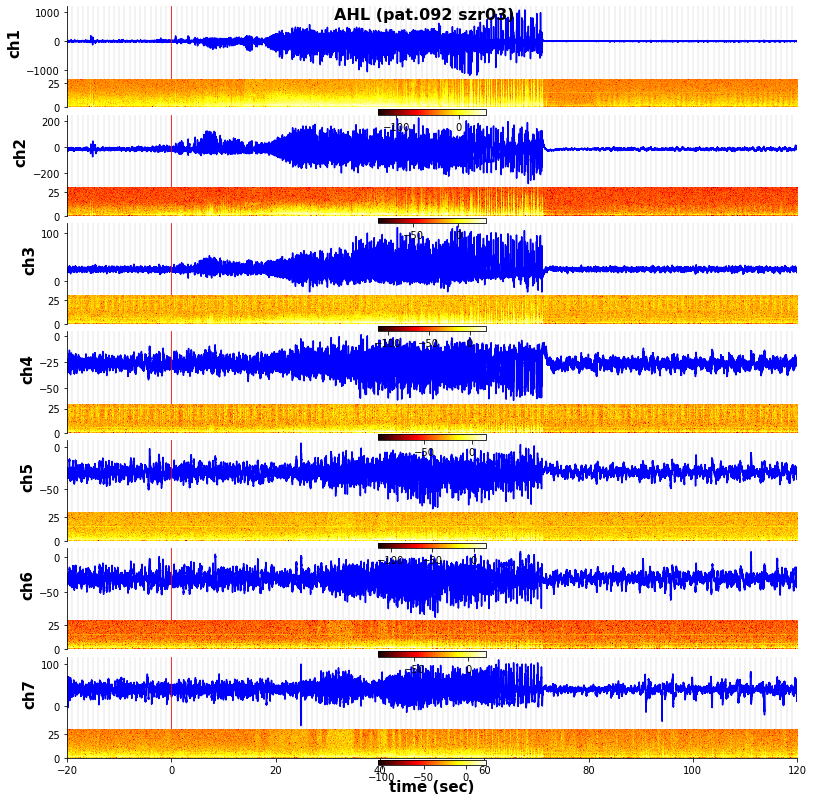

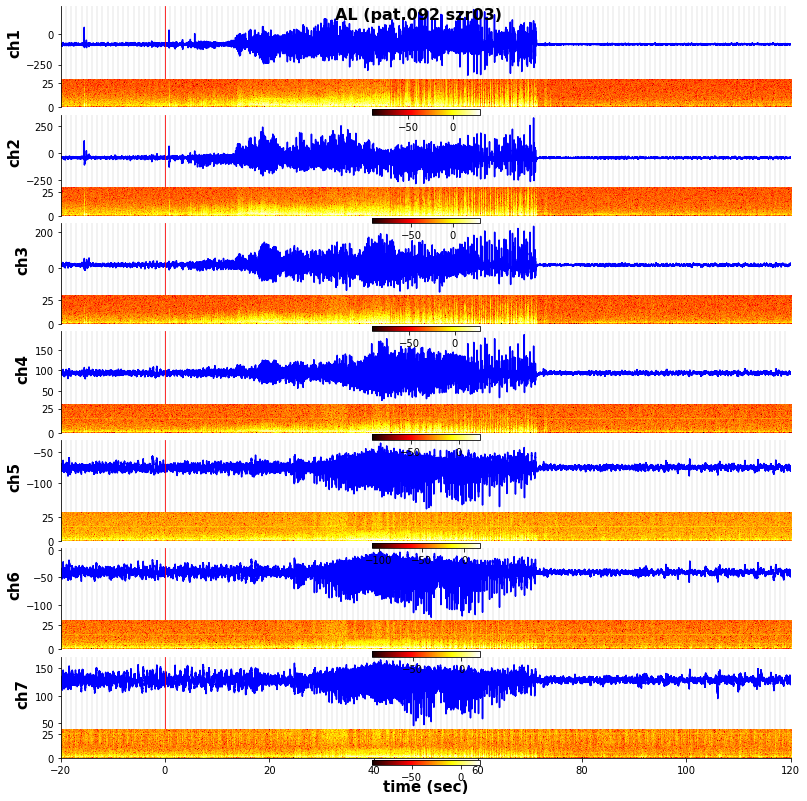

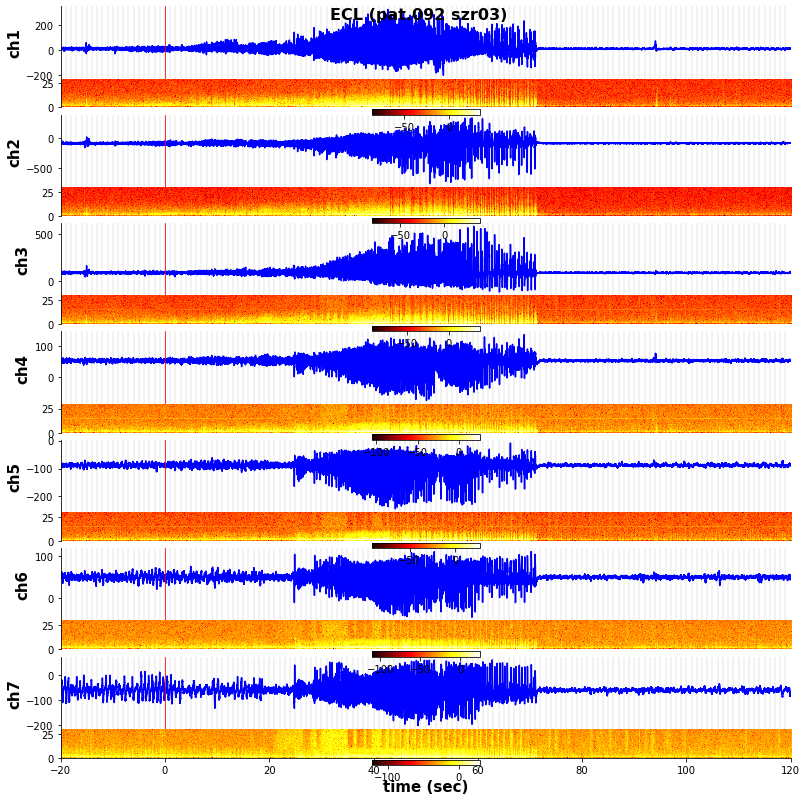

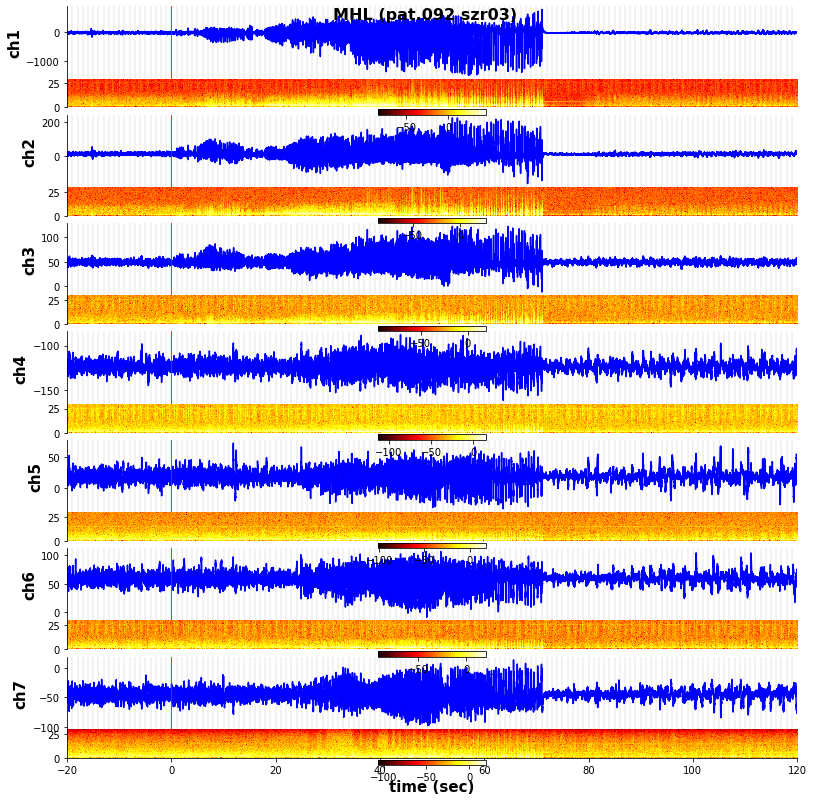

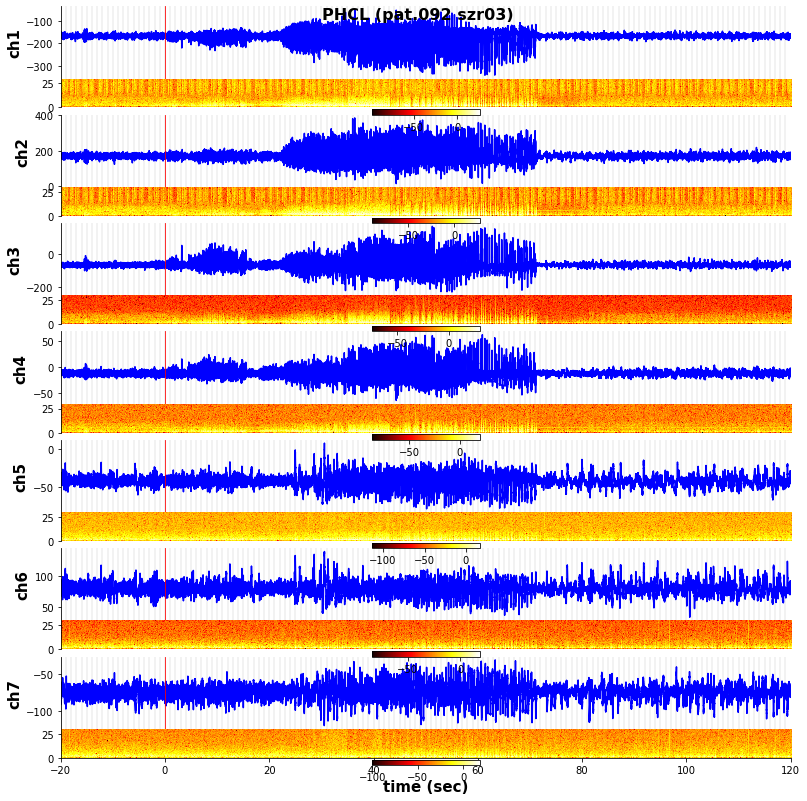

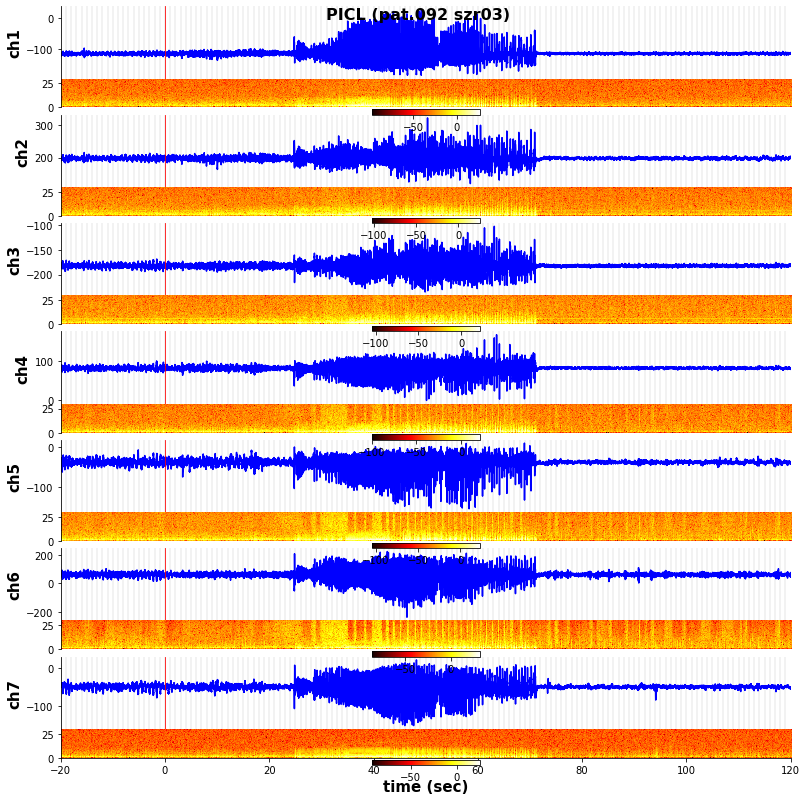

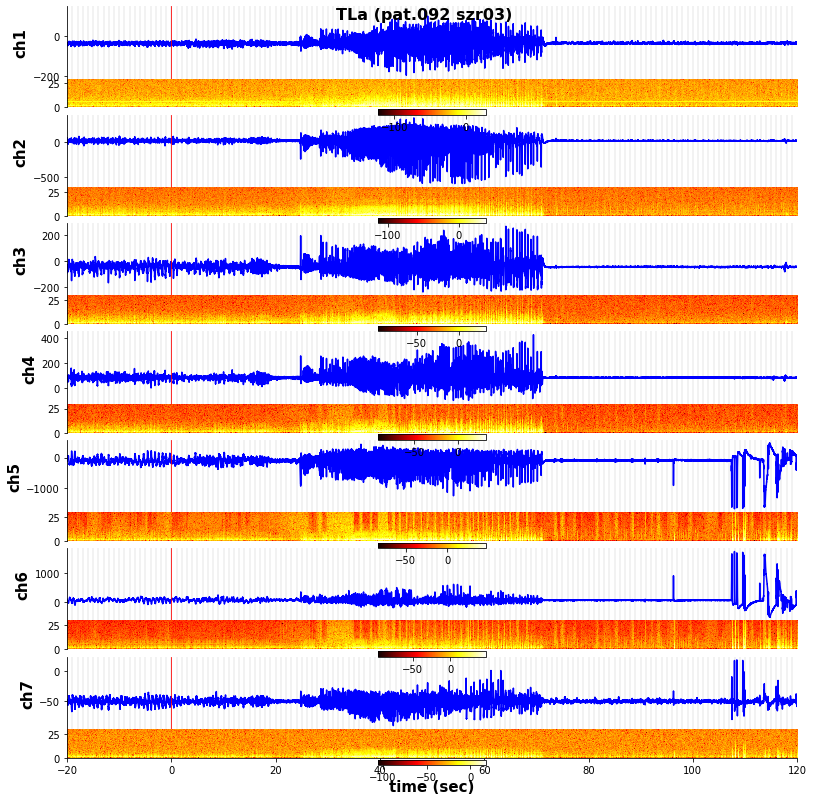

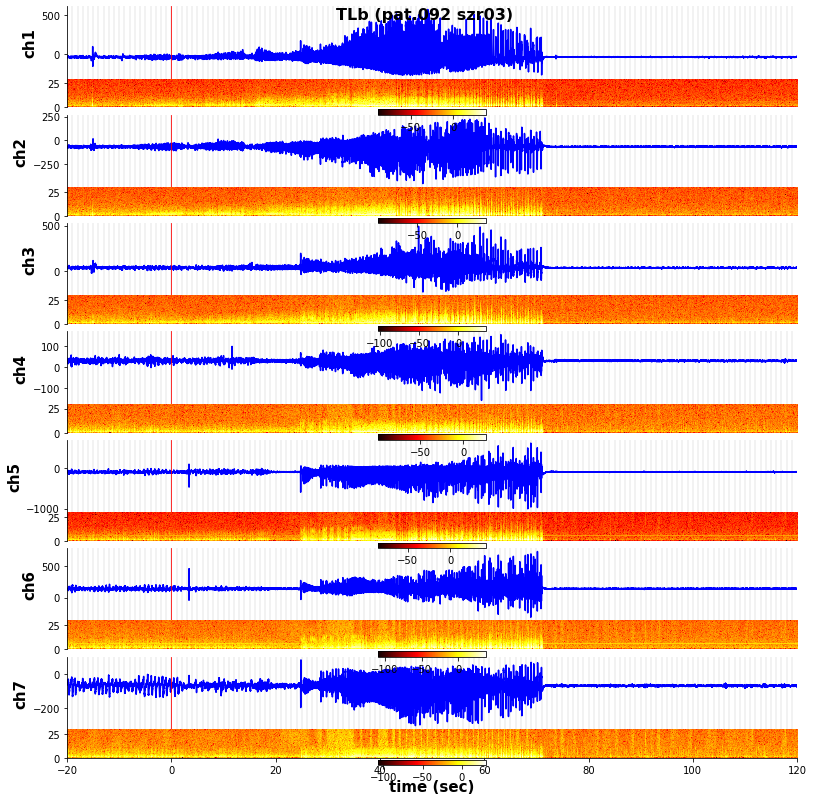

In [15]:
#PLOT PARAMS
my_dpi = 92
onset_sec = (30 * 60) + 0
#sf = 1000
sec_before = 20
sec_after = 120
fmin = 0
fmax = 30

plotFilt = False

if plotFilt:
    if fmin ==0:
        lowfreq = 0.2
    else:
        lowfreq = fmin
# PLOT VARIABLES
all_regions = list(matfiles_dic.keys())
pnr, sznr = get_patinfo_from_path(path)

for ix, reg in enumerate(all_regions):
    curr_reg = matfiles_dic[reg]
    fig, ax = plotObject(nrChannels=len(curr_reg), lenXax=1000, lenYax=1024, shareY=True)
    offsets = np.linspace(-1000, 1000, len(curr_reg))
    #print(reg)
    for i, ch in enumerate(curr_reg):
        file = readMatfile(os.path.join(path_macro, ch))
        data = file.reref_data[(onset_sec * sf) - (sec_before * sf):(onset_sec * sf) + (sec_after * sf)]
        
        timeax = np.linspace(-sec_before, sec_after, len(data))
        offset = offsets[i]
        f_axis, t_axis, spg = spectrogram(data, fs=sf, nperseg=200, noverlap=150, scaling='density')
        
        ax[i*2].plot(timeax, data, c="b")
        
        if plotFilt:
            filt = butter_bandpass_filter(data, lowfreq, fmax, fs=sf, order=1)
            ax[i*2].plot(timeax, filt, c="red", linewidth=0.5)
        
        ax[i*2].set_ylabel(f'ch{i+1}', fontweight='bold', fontsize=15)
        spec = ax[(i*2)+1].imshow(10*np.log10(spg[fmin:fmax,]), aspect='auto', cmap='hot', origin='lower',
                                 extent=[min(timeax), max(timeax), fmin, fmax])#, vmin=-3, vmax=3)
        
        fig.colorbar(spec, ax=ax[(i*2)+1], orientation='horizontal', pad=0.05)
        
        
        
        
        ax[i*2].set_xlim(-sec_before, sec_after)
        ax[i*2].set_xticks(np.arange(-sec_before, sec_after, 1), minor=False)

        # Apply grid settings to individual axes
        ax[i*2].grid(visible=True, which='major', axis='x', linewidth=0.1, color='k')
        ax[i*2].axvline(0, color='red', linewidth=0.8)
        fig.suptitle(f'{reg} (pat.{pnr} szr{sznr})',fontweight="bold", fontsize=16)
        
    ax[(i*2)+1].tick_params(bottom=True, labelbottom=True)
    ax[(i*2)+1].set_xlabel('time (sec)', fontweight='bold', fontsize=15)
plt.show()

In [26]:


dfKeys = ['pnr', 'sznr', 'datapath', 'reg', 'chname', 'SO_sec', 'SO_ts', 'seizureInvadedReg', 'SeizureIndavdedCh']
#dataDict = dict()
dataDf = pd.DataFrame(data = dict(keys=dfKeys))

In [27]:
dataDf.T

,0,1,2,3,4,5,6,7,8
keys,pnr,sznr,datapath,reg,chname,SO_sec,SO_ts,seizureInvadedReg,SeizureIndavdedCh


In [ ]:
def plot_trimodal_per_channel(ts, ma_dat, mi_dat, mx, path, sf, lch, period, mode='datetime', artifacts=False, title=True, 
                              save=True, label='', folder_name='plots_trimodal', freq_th=11):
    #set plot params
    my_dpi = 96
    fig = plt.figure(figsize=(1900/my_dpi, 1024/my_dpi))
    #fig, ax = plt.subplots(3,1, figsize=(1900/my_dpi, 1024/my_dpi))
    #gs = gridspec.GridSpec(6, 2, height_ratios=[1,0.5,1,0.5,2,0.5], width_ratios=[1,0.01]) 
    gs = gridspec.GridSpec(6, 1, height_ratios=[1,0.5,1,0.5,2,0.5])
    #ax2 = plt.subplot(gs[2])
    '''ax0 = plt.subplot(gs[0])
    ax1 = plt.subplot(gs[2], sharex = ax0)
    ax2 = plt.subplot(gs[4], sharex = ax0)
    ax3 = plt.subplot(gs[6], sharex = ax0)
    ax4 = plt.subplot(gs[8], sharex = ax0)
    ax5 = plt.subplot(gs[10], sharex = ax0)
    
    ax6 = fig.add_subplot(gs[1], sharey=ax0)
    ax7 = fig.add_subplot(gs[3], sharey=ax1)
    ax8 = fig.add_subplot(gs[5], sharey=ax2)
    ax9 = fig.add_subplot(gs[7], sharey=ax3)
    ax10 = fig.add_subplot(gs[9], sharey=ax4)
    ax11 = fig.add_subplot(gs[11], sharey=ax5)'''
    
    ax0 = plt.subplot(gs[0])
    ax1 = plt.subplot(gs[1], sharex = ax0)
    ax2 = plt.subplot(gs[2], sharex = ax0)
    ax3 = plt.subplot(gs[3], sharex = ax0)
    ax4 = plt.subplot(gs[4], sharex = ax0)
    ax5 = plt.subplot(gs[5], sharex = ax0)

    #calculate xaxis for macro and micro
    xax_ma = np.linspace(ts[0], ts[-1], len(ma_dat))
    xax_mi = np.linspace(ts[0], ts[-1], len(mi_dat))

    #PLOT MACRO DATA
    ax0.plot(xax_ma, ma_dat)
    
    #calculate spectrogram
    f_ma, t_ma, spg_ma = spectrogram(ma_dat, fs=sf, nperseg=1000, noverlap=150, scaling='density')
    
    #plot spectrogram
    spec_ma = ax1.imshow(np.log10(spg_ma[:freq_th,]), aspect='auto', cmap='jet', origin='lower',
                        extent=[min(xax_ma), max(xax_ma), min(f_ma), freq_th])
    #fig.colorbar(spec_ma, cax=ax7, ax=ax7, orientation='horizontal')
    fig.colorbar(spec_ma, ax=ax1, orientation='horizontal')
    
    #PLOT MICRO DATA
    ax2.plot(xax_mi, mi_dat)
    
    #calculate spectrogram
    f_mi, t_mi, spg_mi = spectrogram(mi_dat, fs=1000, nperseg=1000, noverlap=150, scaling='density')
    
    #plot spectrogram
    spec_mi = ax3.imshow(np.log10(spg_mi[:freq_th,]), aspect='auto', cmap='jet', origin='lower',
                        extent=[min(xax_ma), max(xax_ma), min(f_mi), freq_th])
    #fig.colorbar(spec_mi, cax=ax9, ax=ax9)
    fig.colorbar(spec_mi, ax=ax3, orientation='horizontal')
    
    if not artifacts:
        #ax2.eventplot(mx[1:],linewidths=0.4, linelengths=.9, colors=['red', 'blue'], alpha=1)
        ax4.eventplot(mx,linewidths=0.4, linelengths=.9, colors=['blue'], alpha=1)
    else:
        ax4.eventplot(mx,linewidths=0.4, linelengths=.9, colors=['green', 'red', 'blue'], alpha=1)
    ax4.set_xlim(ts[0], ts[-1])
    
    #calculate histogram for firingrates:
    window = np.arange(min(ts), max(ts), 1000*1e3)
    hist = []

    for i in mx:
        hist.append(np.histogram(i, window)[0])
    
    hist = np.nanmean(hist, axis=0)
    #print(hist, type(hist.shape))
    #if type(hist) == 'tuple':
    hist_xaxis = np.linspace(ts[0], ts[-1], hist.shape[0])
    ax5.plot(hist_xaxis, hist)
    #else:
    #    hist = [0*240]

    #fix plot's xaxis
    max_ts = max(ts) + (period%60)*sf
    xaxis_min = ((np.linspace(min(ts), max_ts, 10))).tolist()
    xaxis_maj = ((np.linspace(min(ts), max_ts, int(period/60)+1))).tolist()
    #hist_xaxis = 
    ax5.set_xticks(xaxis_maj)
    
    #xaxis_min_specma = ((np.linspace(min(ts), max(ts), 10))).tolist()
    #xaxis_maj_spe = ((np.linspace(min(ts), max(ts), int(int(period)/60)+1))).tolist()

    if mode == 'datetime':
        datetime_ts = [dt.datetime.utcfromtimestamp(ts[i]/1e6) for i in range(len(ts))]
        xaxis_maj_2 = datetime_ts[::sf*60]
        labels_yaxis = [(str(a).split(' ')[-1]).split('.')[0] for a in xaxis_maj_2]
        ax5.set_xticklabels(labels_yaxis, fontsize=8, fontweight='bold')
        ax5.set_xlabel('time (HH:MM:SS)', fontweight='bold', fontsize=12)
        plt.xticks(rotation=45)
    else:
        xplot = np.linspace(0, int(period), int(period))
        #xplot_spec_ma = np.linspace(0, int(period), len(t_ma))
        label_xaxis = [str(int(x)) for x in xplot]
        ax5.set_xticks(xaxis_min, minor=True)
        ax5.set_xticklabels(label_xaxis, fontsize=8, fontweight='bold')
        ax5.set_xlabel('time (min)', fontweight='bold', fontsize=15)
        #ax2.se

    #fix yaxis ticks
    ax0.set_yticks([])
    #ax0.set_xticks([])
    ax1.set_yticks(np.linspace(min(f_mi),freq_th,5))
    #ax1.set_xticks([])
    ax2.set_yticks([])
    ax3.set_yticks(np.linspace(min(f_ma),freq_th,5))
    ax4.set_yticks([])
    ax5.set_yticks(np.linspace(min(hist), max(hist), 3))
    
    #ax7.set_yticks([])
    #ax9.set_yticks([])
    
    spines = ('top', 'right', 'bottom')
    spines_all = ('top', 'right', 'bottom', 'left')
    
    for sp in spines:
        ax0.spines[sp].set_visible(False)
        ax1.spines[sp].set_visible(False)
        ax2.spines[sp].set_visible(False)
        ax3.spines[sp].set_visible(False)
        ax4.spines[sp].set_visible(False)
    
    '''for sp in spines_all:
        ax6.spines[sp].set_visible(False)
        ax7.spines[sp].set_visible(False)
        ax8.spines[sp].set_visible(False)
        ax9.spines[sp].set_visible(False)
        ax10.spines[sp].set_visible(False)
        ax11.spines[sp].set_visible(False)'''
    '''ax0.spines[('top', 'right', 'bottom')].set_visible(False)
    #ax0.spines['right'].set_visible(False)
    #ax0.spines['bottom'].set_visible(False)
    ax1.spines['top'].set_visible(False)
    ax1.spines['right'].set_visible(False)
    ax1.spines['bottom'].set_visible(False)
    ax2.spines['top'].set_visible(False)
    ax2.spines['right'].set_visible(False)
    ax2.spines['bottom'].set_visible(False)
    ax3.spines['top'].set_visible(False)
    ax3.spines['right'].set_visible(False)
    ax3.spines['bottom'].set_visible(False)
    ax4.spines['top'].set_visible(False)
    ax4.spines['right'].set_visible(False)
    ax4.spines['bottom'].set_visible(False)'''
    ax5.spines['top'].set_visible(False)
    ax5.spines['right'].set_visible(False)
    #ax5.spines['bottom'].set_visible(False)

    #set yaxis labels
    ax0.set_ylabel(ma[1], fontweight='bold', fontsize=12)
    ax1.set_ylabel('freq (Hz)', fontweight='bold', fontsize=12)
    ax2.set_ylabel(mi[1].split('.')[0], fontweight='bold', fontsize=12)
    ax3.set_ylabel('freq (Hz)', fontweight='bold', fontsize=12)
    ax4.set_ylabel('Units', fontweight='bold', fontsize=12)
    ax5.set_ylabel('mean FR (Hz)', fontweight='bold', fontsize=12)

    #if not artifacts:
    #    ax2.legend(["SU", "MU"], loc='upper right')
    #else:
    #    ax2.legend(["Artifact", "SU", "MU"], loc='upper right')


    plt.subplots_adjust(hspace=.0)
    #plt.grid(visible=True, which='major', axis='x', linewidth=0.8, color='k')
    #plt.show()

    #get figure title
    if mode=='datetime':
        title_datetime_str = dt.datetime.strftime(datetime_ts[0], '%Y-%m-%d_%H-%M-%S')
    else:
        title_datetime_str = dt.datetime.strftime(dt.datetime.utcfromtimestamp(ts[0]/1e6), 
                                                  '%Y-%m-%d_%H-%M-%S')
    #set figure title
    if title:
        #get patient number and seizure number
        expr = re.compile('(.*)(\d{4}-\d{2}-\d{2}_\d{2}-\d{2}-\d{2})(.*)')
        match = expr.search(path)
        session = match.group(2)
        basepath = find_dir(path, session)
        pnr, snr = get_patinfo_from_path(basepath)


        #figure title
        fig.suptitle(f'Patient {pnr} seizure {snr} ({title_datetime_str})', 
                     fontweight="bold", fontsize=16)
    if save:
        print('saving plot...')
        #Fix path ending with /
        if os.path.basename(path) == '':
            path = os.path.split(path)[0]
        
        out_path = os.path.join(path, folder_name)
        if not os.path.exists(out_path):
            print('created /plots_trimodal directory')
            os.mkdir(out_path)
        
        figname = out_path + '/' + title_datetime_str + '_' + lch + '_trimodal'
        if len(label):
             figname = figname + '_' + label
        
        figname += '.eps'
        
        plt.savefig(figname, dpi=600, format='eps')
        print(f'figure {figname} saved in {path}') 